In [1]:
""" Step 1: Preprare the problem """
# 1.1. Load the libraries 
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

import plotly.express as px

from sklearn.metrics import average_precision_score, roc_auc_score, accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.model_selection import ShuffleSplit

from sklearn.tree import export_graphviz
import graphviz
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.decomposition import PCA

from keras.models import Sequential
from keras.layers.core import Dense

import tensorflow 
from keras.models import Model, load_model
from keras.layers import Input, Dense
from keras.callbacks import ModelCheckpoint
from keras import regularizers
from sklearn.metrics import mean_squared_error

import warnings
warnings.filterwarnings("ignore")

In [2]:
# 1.2. Load the ML preparation class
from Supported_module.load_data import dataset
from Supported_module.prepare_data import data_preparation, Dimensionality_Reduction_visualisation, sampling

# 1.3. Load function for ML model
from Supported_module.evaluate_ML import cross_validate, model_best_estimator, evaluate_model, train_model, predict_model, plot_result, plot_learning_curve

In [3]:
# 1.3. Load dataset
data = dataset('Dataset\creditcard.csv')


In [4]:
""" Step 2: Summarise the data """
# 2.1. Brief information in the dataset
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [5]:
# 2.2. Check missing value
data.check_missing()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64


In [6]:
# 2.3. Check duplicated value & drop it
data.check_duplicate()
df = data.drop_duplicate()

Number of duplicated valued 1081


In [7]:
# 2.4. Descriptive statistics
data.descriptive()

                Time             V1             V2             V3  \
count  283726.000000  283726.000000  283726.000000  283726.000000   
mean    94811.077600       0.005917      -0.004135       0.001613   
std     47481.047891       1.948026       1.646703       1.508682   
min         0.000000     -56.407510     -72.715728     -48.325589   
25%     54204.750000      -0.915951      -0.600321      -0.889682   
50%     84692.500000       0.020384       0.063949       0.179963   
75%    139298.000000       1.316068       0.800283       1.026960   
max    172792.000000       2.454930      22.057729       9.382558   

                  V4             V5             V6             V7  \
count  283726.000000  283726.000000  283726.000000  283726.000000   
mean       -0.002966       0.001828      -0.001139       0.001801   
std         1.414184       1.377008       1.331931       1.227664   
min        -5.683171    -113.743307     -26.160506     -43.557242   
25%        -0.850134      -0.6898

After removing duplicated value: (283726, 31)
Number of Non-Fraudulent Transactions = 283253
Number of Fraudulent Transactions = 473
Percent of Non-Fraudulent Transactions = 99.83%
Percent of Fraudulent Transactions = 0.17%


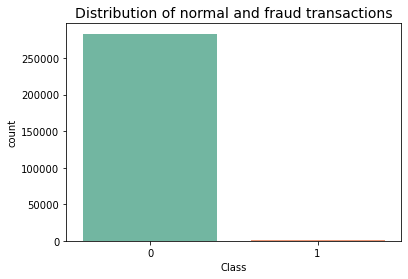

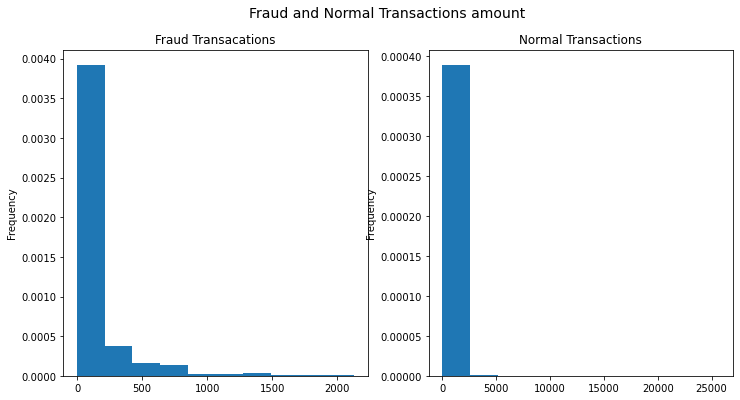

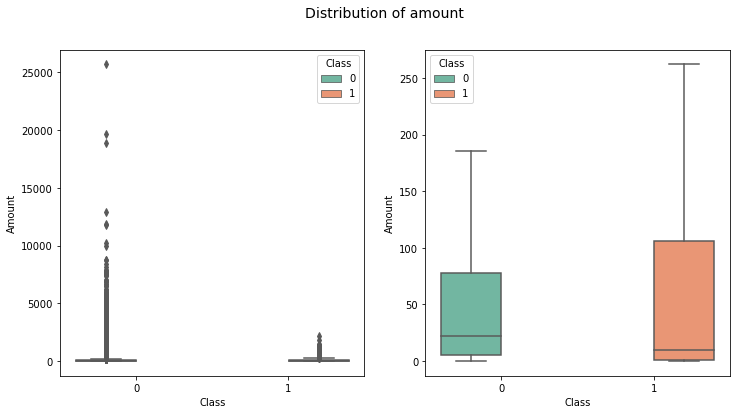

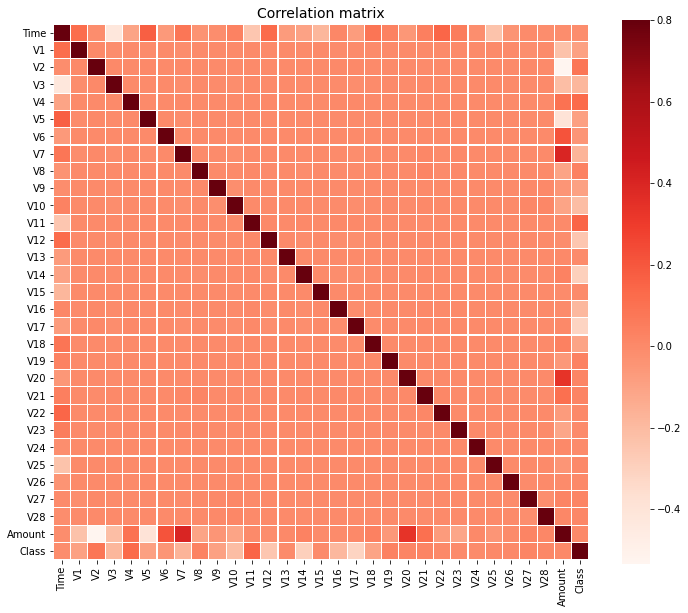

<Figure size 432x288 with 0 Axes>

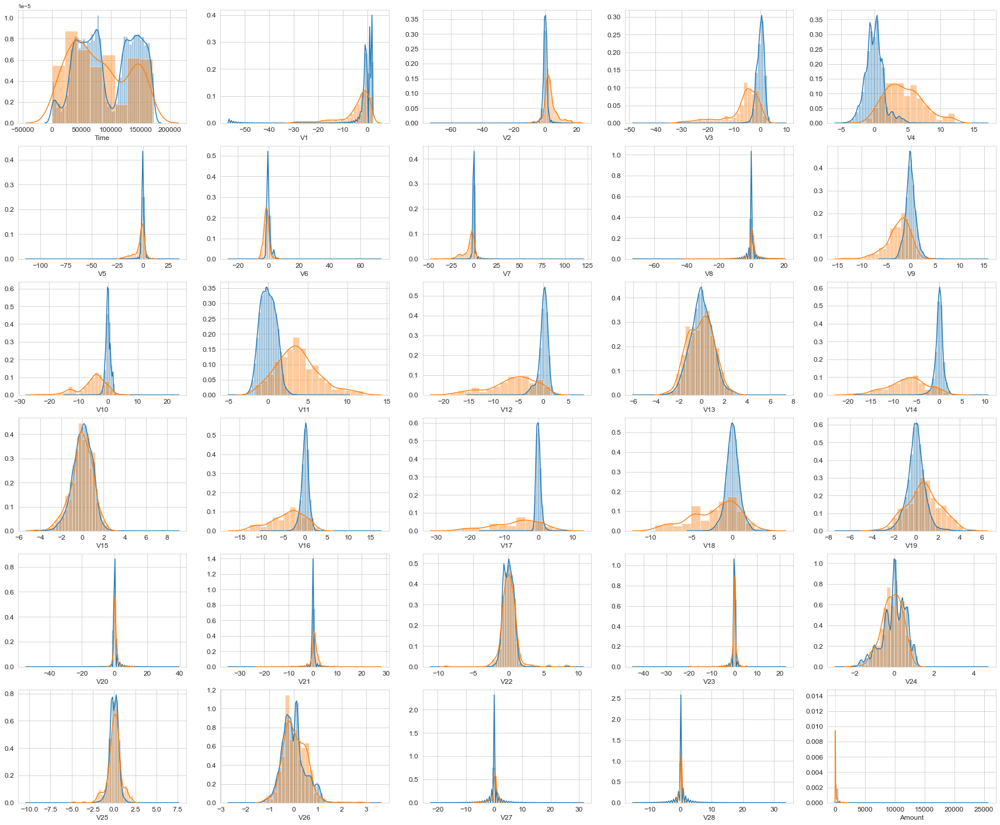

In [8]:
# 2.5. Data Visualisation
# Number of fraud and non-fraud transaction
data.count_value()

# Plot amount
data.plot_amount()

# Plot outlier
data.plot_outlier()

# Data correlation matrix
data.correlation()

# Data density plot
data.plot_density()

In [9]:
""" Step 3: Prepare for ML"""
# To reduce the training time and imblance data, I will get a sample size of 5,000 from dataset
new_df = data_preparation(df, 5000)

# 3.1. Normalise data. This dataset was the result of PCA except for Time and Amount
# Then, I normalise the amount column into a new column called normAmount
new_df.scale_data()

# 3.2. Remove unused column (in this case is Time and Amount)
new_df.pre_process()

# 3.3. Get sample data
new_df.get_resample()


After resampling, Number of Fraudulent Transactions : 473
After resampling, Number of Normal Transactions : 5000


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Class,normAmount
0,0.682783,-0.486335,0.012839,1.598749,-0.386649,-0.482646,0.583423,-0.185431,-0.006053,-0.168241,...,0.168220,0.103013,-0.301318,0.442614,0.630720,-0.278901,-0.021788,0.058078,0,3.277430
1,-1.282893,1.316584,1.324775,-0.215741,-0.221084,-0.790256,0.551102,0.109837,-0.034738,0.798524,...,-0.277691,-0.525917,0.129445,0.495377,-0.077373,0.060889,0.580973,0.331331,0,-0.181060
2,-4.374232,4.597323,-2.666504,-0.495896,-0.335102,1.979937,-5.900575,-11.761583,-2.595467,-3.807796,...,-6.200810,1.783418,0.631746,-1.187762,-0.086872,0.155966,-0.524525,0.190889,0,-0.295369
3,-0.292081,1.071984,-1.174271,-1.159829,0.953344,-1.018811,1.119461,0.224547,-0.726487,-0.702866,...,0.374359,0.888647,-0.136599,0.714972,-0.431407,0.027988,0.008789,0.138837,0,-0.177305
4,-0.944245,2.111158,-1.537880,1.107202,0.869840,-0.671514,0.765541,0.611146,-0.997267,-0.962613,...,0.116370,0.340450,-0.181721,0.490990,0.100500,-0.408542,0.079898,0.136128,0,-0.053678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5468,0.869332,-0.767640,1.037434,1.007216,-1.365051,-0.276023,-0.498800,0.104875,1.107400,-0.277243,...,-0.009020,-0.261033,-0.094788,0.406980,0.151584,0.303528,-0.021996,0.052610,0,2.058128
5469,-0.908891,1.537423,1.113417,-0.135874,-0.068233,-0.982772,0.886386,-0.231785,0.413281,0.634794,...,-0.415552,-0.778837,-0.011376,0.300315,-0.052464,0.059931,0.400908,0.051247,0,-0.139202
5470,-3.114951,1.306373,0.348303,-0.018720,-0.484950,-1.141407,0.088273,0.053132,0.851922,1.389700,...,-0.303998,-0.785142,-0.170337,0.368409,-0.650979,-0.143822,-0.557996,0.674828,0,0.013906
5471,1.216717,-0.613836,-0.232052,-0.716157,-0.604758,-0.777757,0.018105,-0.235781,-1.457619,0.807264,...,-0.654481,-1.697849,0.092903,0.004197,0.083071,0.697698,-0.102637,0.008098,0,1.125017


After resampling, Number of Fraudulent Transactions : 473
After resampling, Number of Normal Transactions : 5000


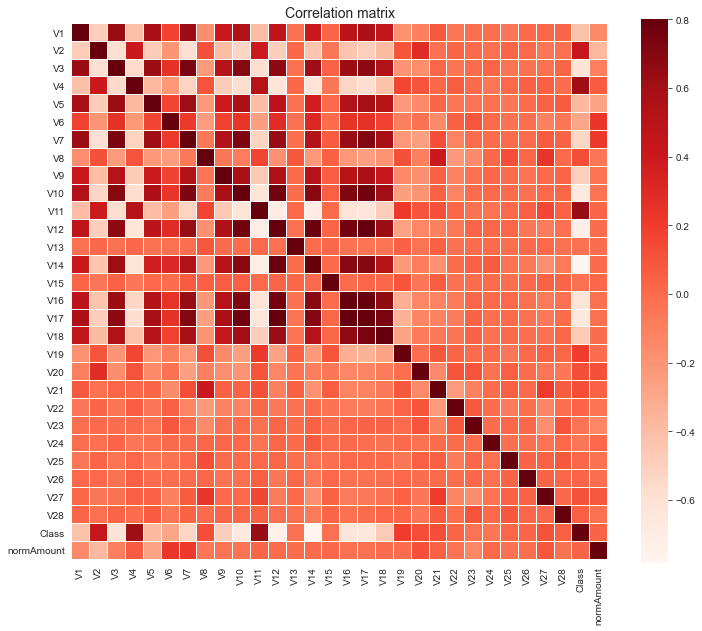

After resampling, Number of Fraudulent Transactions : 473
After resampling, Number of Normal Transactions : 5000


<Figure size 432x288 with 0 Axes>

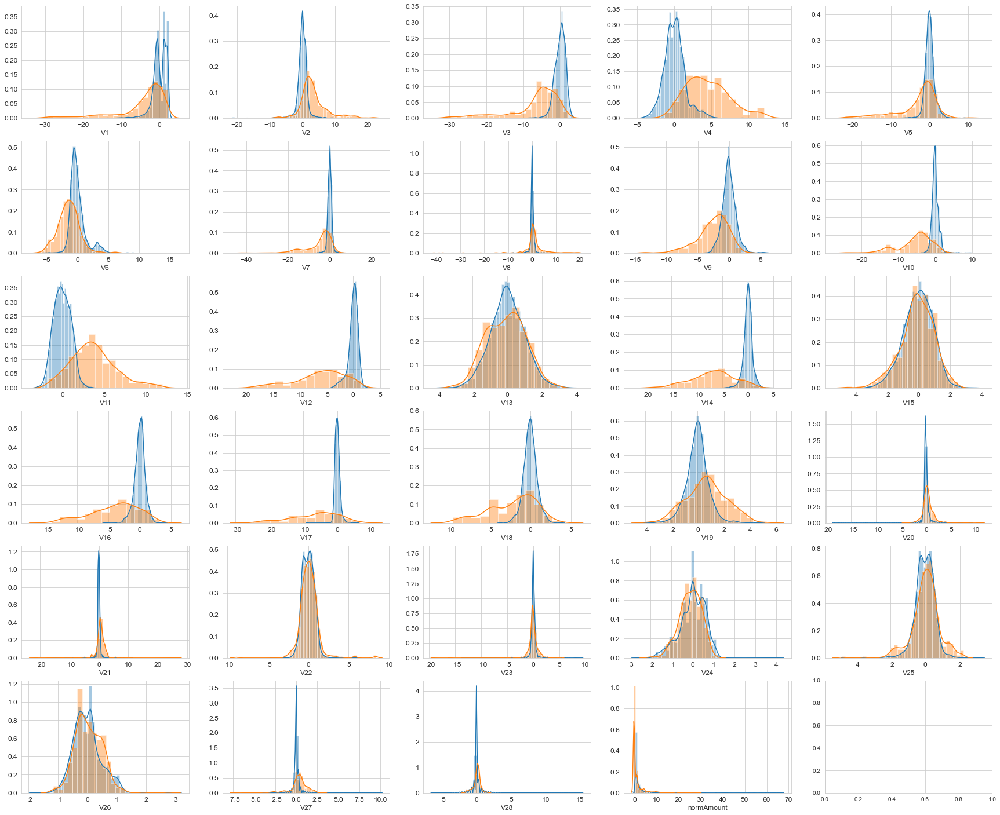

In [10]:
# 3.4 Sample visualisation
new_df.correlation()
new_df.plot_density()

In [11]:
# 3.5. Split train and test set for sample data

X_train, X_test, y_train, y_test = new_df.split_resampledata()
print(X_train.shape)
print(X_test.shape)


After resampling, Number of Fraudulent Transactions : 473
After resampling, Number of Normal Transactions : 5000
----------------------------------------------------
For the resample data 5000 normal transacions
Number transactions X_train dataset:  (4378, 29)
Number transactions y_train dataset:  (4378,)
Number transactions X_test dataset:  (1095, 29)
Number transactions y_test dataset:  (1095,)
----------------------------------------------------
Number of Fraudulent Transactions in train set : 374
Number of Normal Transactions in train set : 4004
Number of Fraudulent Transactions in test set : 99
Number of Normal Transactions in test set : 996
(4378, 29)
(1095, 29)


In [12]:
# 3.6 Sampling - to solve imbalance dataset
# Here I will experiment two type of sampling (under and oversampling) for training set
df_sampling = sampling(X_train, y_train)
X_train_nm, y_train_nm = df_sampling.undersampling()
X_train_sm, y_train_sm =df_sampling.oversampling()


After UnderSampling, counts of fraud: 374
After UnderSampling, counts of normal: 374

After OverSampling, counts of fraud: 4004
After OverSampling, counts of normal: 4004

After OverSampling, the shape of X train: (8008, 29)
After OverSampling, the shape of y train: (8008,) 



In [13]:
""" Step 4: Evaluate Algorithms"""

# 4.1 Design ML model - Set up
RANDOM_STATE = 38

# Define ML algorithms
classifiers = {
    "LogisiticRegression": LogisticRegression(random_state=RANDOM_STATE),
    "KNearest": KNeighborsClassifier(),
    "DecisionTreeClassifier": DecisionTreeClassifier(random_state=RANDOM_STATE),
    "Random Forest Classifier": RandomForestClassifier(random_state=RANDOM_STATE)
}

# The dataset is imbalance, I used class weight to adjust for the normal case
CLASS_WEIGHT = round(np.count_nonzero(y_train == 0)/ np.count_nonzero(y_train == 1),2)
print(CLASS_WEIGHT)

10.71


After resampling, Number of Fraudulent Transactions : 473
After resampling, Number of Normal Transactions : 5000
T-SNE took 59.74347400665283 s
PCA took 0.058 s


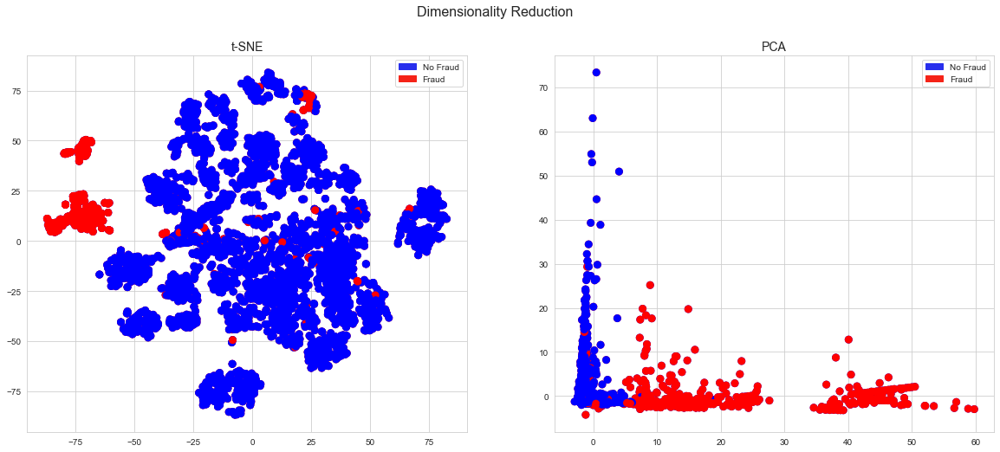

In [14]:
""" Features selection visualisation"""

# 4.2 Check dimension reduction - Visualise with PCA and TSNE for the sample data
sample = new_df.get_resample()
visual = Dimensionality_Reduction_visualisation(sample)
visual.plot_reduce_dimension()

In [15]:
# 4.3 Check PCA explained variance
pca = PCA()
pca.fit(X_train)
exp_var_cumul = np.cumsum(pca.explained_variance_ratio_)

fig = px.area(
    x=range(1, exp_var_cumul.shape[0] + 1),
    y=exp_var_cumul,
    labels={"x": "# Components", "y": "Explained Variance"}
)
fig.add_hline(y=0.9)

In [16]:
# 4.4 Set up function for training and testing flow
# Start with find the best parameter for ML model, train and get result + visualisation results

def train_test(X_train, y_train, X_test, y_test, class_weight=None, RANDOM_STATE=RANDOM_STATE, cv=5):
    # Find best parameter for model
    model_select_result = model_best_estimator(X_train, y_train, class_weight=class_weight)
    
    log_reg, knn, tree_clf, rf = model_select_result
    
    
    # Train and get result
    for classifier in model_select_result:
        print("\nPredict model:", classifier)
        evaluate_model(classifier, X_train, y_train, cv=cv)
        print("\nTraining result:")
        train_model(classifier, X_train, y_train, cv=cv)
        print("Testing result:")
        predict_model(classifier, X_test, y_test)
        
    
    # Plot learning curve:
    cv1 = ShuffleSplit(n_splits=cv, test_size=0.2, random_state=RANDOM_STATE)
    
    plot_learning_curve(log_reg, knn, tree_clf, rf, X_train, y_train, 
                        (0.85, 1.01), cv=cv1, n_jobs=4)
    
    # Plot result (ROC, Precision)
    print('Plot for training results')
    plot_result(log_reg, knn, tree_clf, rf, X_train, y_train)
    print('Plot for test results')
    plot_result(log_reg, knn, tree_clf, rf, X_test, y_test)
    
    
    #can add feature importance
    return [log_reg, knn, tree_clf, rf]

In [17]:
# Features extract with PCA
def select_PCA(X_train, X_test, COMPONENTS=10):

    # Tranform X train, X test
    pca = PCA(n_components=COMPONENTS, random_state=RANDOM_STATE).fit(X_train)
    X_train_pca = pca.transform(X_train)
    X_test_pca = pca.transform(X_test)
    print("X_train_pca.shape: {}".format(X_train_pca.shape))

    return [X_train_pca, X_test_pca]




************* Normal Case - Baseline **************
Initial evaluate training model
Classifiers:  LogisticRegression has a training accuracy score of 98.0 %
Classifiers:  KNeighborsClassifier has a training accuracy score of 98.0 %
Classifiers:  DecisionTreeClassifier has a training accuracy score of 97.0 %
Classifiers:  RandomForestClassifier has a training accuracy score of 99.0 %
Best fit parameter for Log regression LogisticRegression(C=1, max_iter=10000, random_state=38, solver='liblinear')
Elapsed time 20.19 s

Best fit parameter for KNN KNeighborsClassifier(n_neighbors=3)
Effective metric: euclidean
Elapsed time 19.20 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(max_depth=5, min_samples_leaf=6, random_state=38)
Elapsed time 15.93 s

Best fit parameter for Random Forest: RandomForestClassifier(criterion='entropy', max_depth=5, min_samples_leaf=2,
                       random_state=38)
Elapsed time 180.07 s

Predict model: LogisticRegression(C=1, max_iter=1000

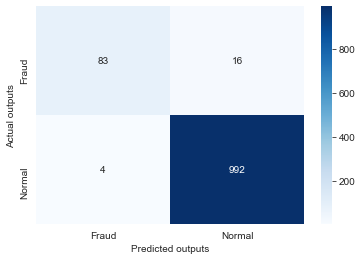


Predict model: KNeighborsClassifier(n_neighbors=3)

Training result:
              precision    recall  f1-score   support

           1       0.97      0.87      0.92       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.98      0.93      0.95      4378
weighted avg       0.99      0.99      0.99      4378

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.85      0.92        99
           0       0.99      1.00      0.99       996

    accuracy                           0.99      1095
   macro avg       0.99      0.92      0.96      1095
weighted avg       0.99      0.99      0.99      1095

Confusion matrix: KNeighborsClassifier(n_neighbors=3)


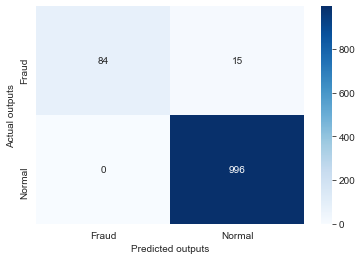


Predict model: DecisionTreeClassifier(max_depth=5, min_samples_leaf=6, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.97      0.84      0.90       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.98      4378
   macro avg       0.98      0.92      0.95      4378
weighted avg       0.98      0.98      0.98      4378

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.82      0.90        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.99      0.91      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: DecisionTreeClassifier(max_depth=5, min_samples_leaf=6, random_state=38)


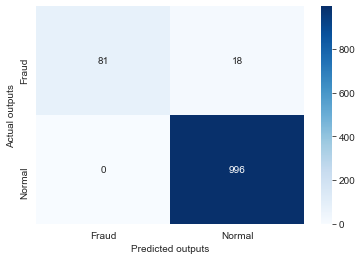


Predict model: RandomForestClassifier(criterion='entropy', max_depth=5, min_samples_leaf=2,
                       random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.99      0.84      0.91       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.99      0.92      0.95      4378
weighted avg       0.99      0.99      0.99      4378

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.83      0.91        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.99      0.91      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(criterion='entropy', max_depth=5, min_samples_leaf=2,
                       random_state=38)


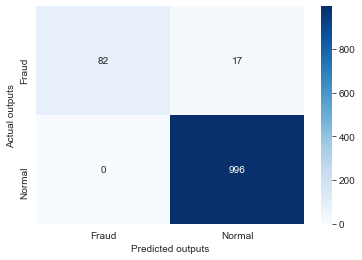

Plot for training results


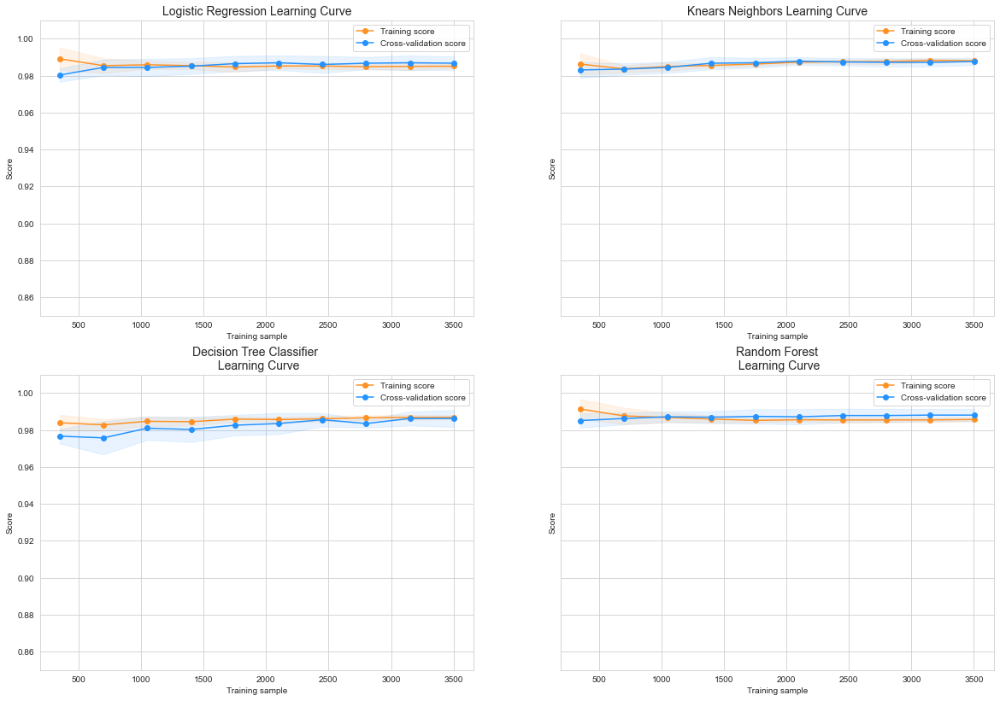

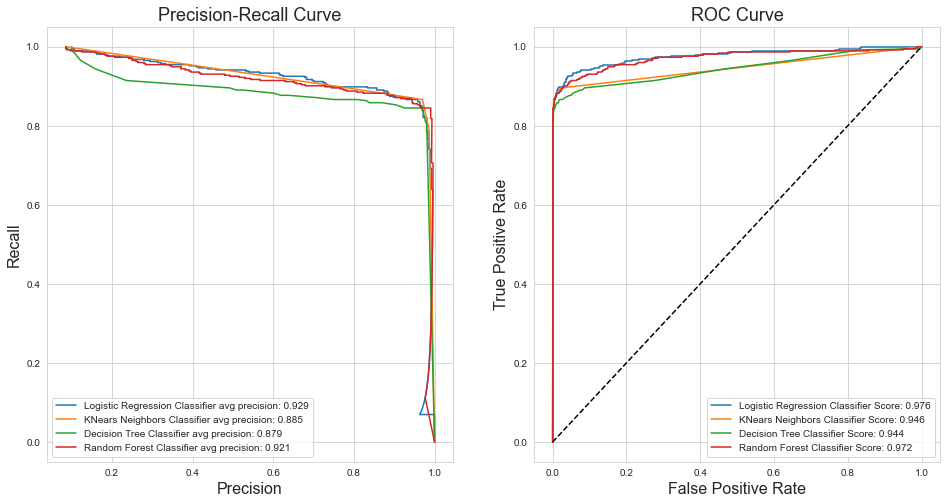

Plot for test results


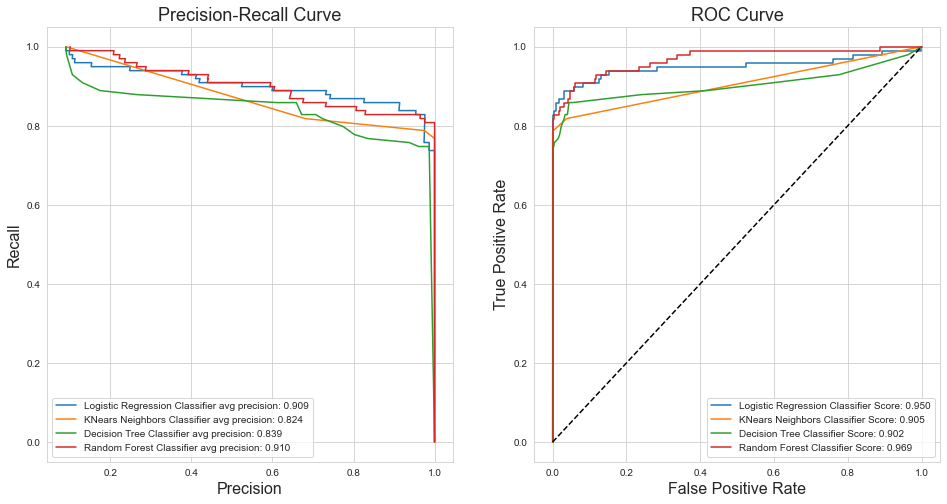

In [18]:
### Experiment 1a: Baseline - Without doing any sampling or class weight to resolve imbalance problem

# 4.5 Train model
print("\n************* Normal Case - Baseline **************")

# Intial evaluate train model with 5 fold cross-validation
print("Initial evaluate training model")
cross_validate(X_train, y_train)

# 4.6 Improve model, avoid overfitting and find optimal hyperparameter by applying GridSearchCV
# Evaluate model and get result
log_reg, knn, tree_clf, rf = train_test(X_train, y_train, X_test, y_test)

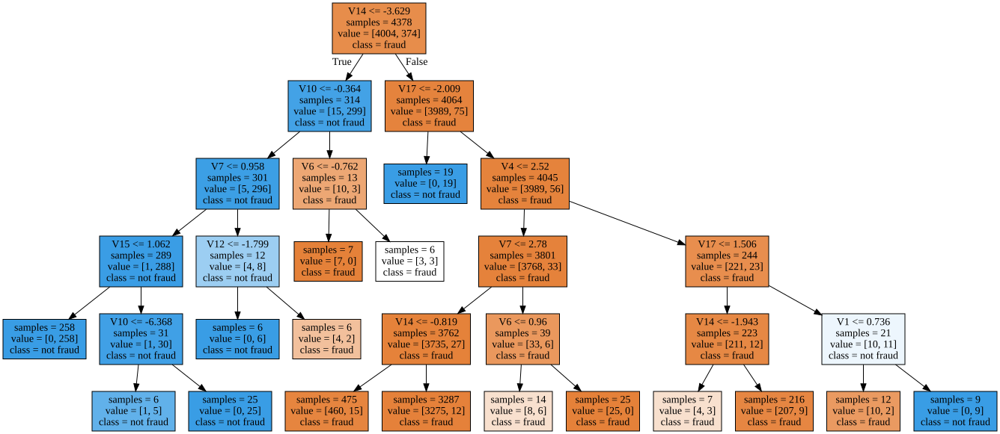

In [19]:
# Visualise decision tree
export_graphviz(tree_clf, out_file="tree.dot", class_names=["fraud", "not fraud"], feature_names=list(X_train), impurity=False, filled=True)
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

X_train_pca.shape: (4378, 10)

************* PCA applied on Baseline case **************
Best fit parameter for Log regression LogisticRegression(C=0.1, max_iter=10000, random_state=38, solver='liblinear')
Elapsed time 4.62 s

Best fit parameter for KNN KNeighborsClassifier(n_neighbors=7)
Effective metric: euclidean
Elapsed time 6.13 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(max_depth=4, min_samples_leaf=5, random_state=38)
Elapsed time 4.34 s

Best fit parameter for Random Forest: RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)
Elapsed time 131.74 s

Predict model: LogisticRegression(C=0.1, max_iter=10000, random_state=38, solver='liblinear')

Training result:
              precision    recall  f1-score   support

           1       0.98      0.84      0.90       374
           0       0.98      1.00      0.99      4004

    accuracy                           0.98      4378
   macro avg       0.98      0.92      0.95      4378
weighted av

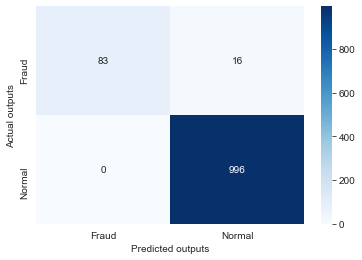


Predict model: KNeighborsClassifier(n_neighbors=7)

Training result:
              precision    recall  f1-score   support

           1       0.98      0.86      0.92       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.99      0.93      0.95      4378
weighted avg       0.99      0.99      0.99      4378

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.84      0.91        99
           0       0.98      1.00      0.99       996

    accuracy                           0.99      1095
   macro avg       0.99      0.92      0.95      1095
weighted avg       0.99      0.99      0.98      1095

Confusion matrix: KNeighborsClassifier(n_neighbors=7)


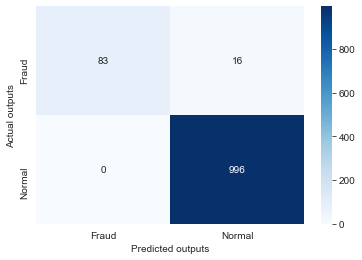


Predict model: DecisionTreeClassifier(max_depth=4, min_samples_leaf=5, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.96      0.86      0.90       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.98      4378
   macro avg       0.97      0.93      0.95      4378
weighted avg       0.98      0.98      0.98      4378

Testing result:
              precision    recall  f1-score   support

           1       0.98      0.83      0.90        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.98      0.91      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: DecisionTreeClassifier(max_depth=4, min_samples_leaf=5, random_state=38)


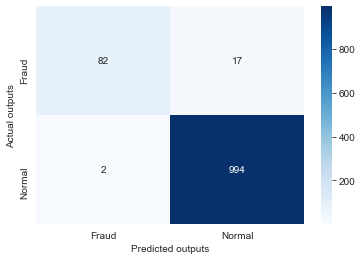


Predict model: RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.98      0.85      0.91       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.98      0.92      0.95      4378
weighted avg       0.99      0.99      0.98      4378

Testing result:
              precision    recall  f1-score   support

           1       0.98      0.83      0.90        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.98      0.91      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)


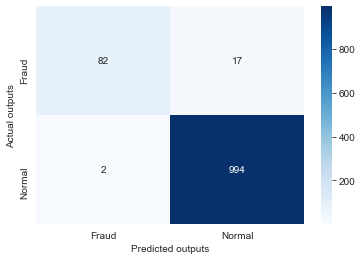

Plot for training results


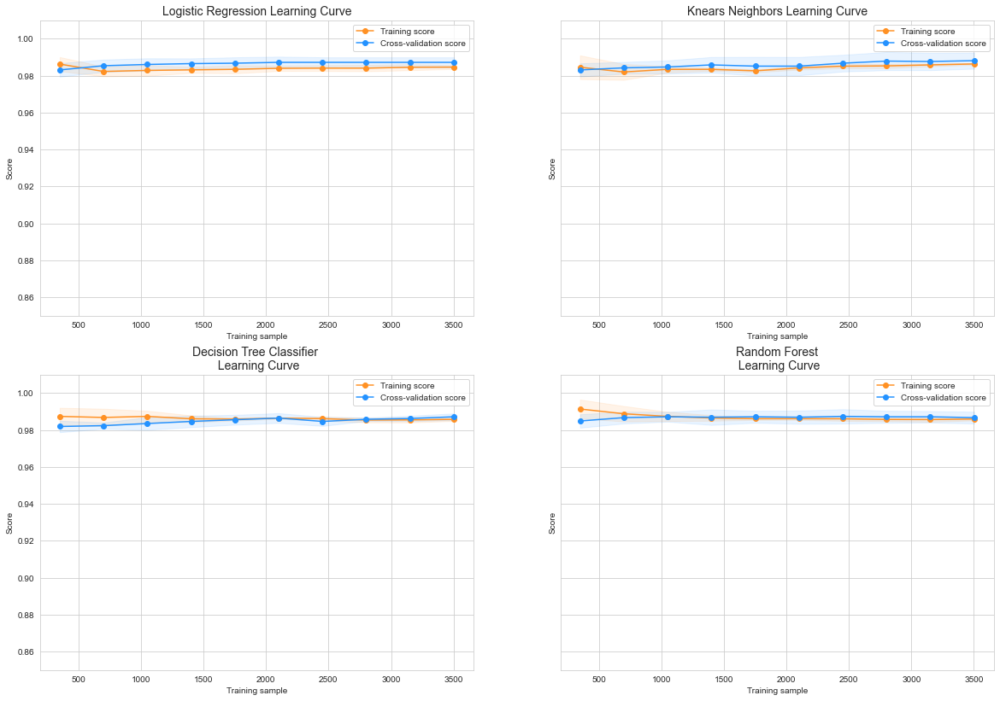

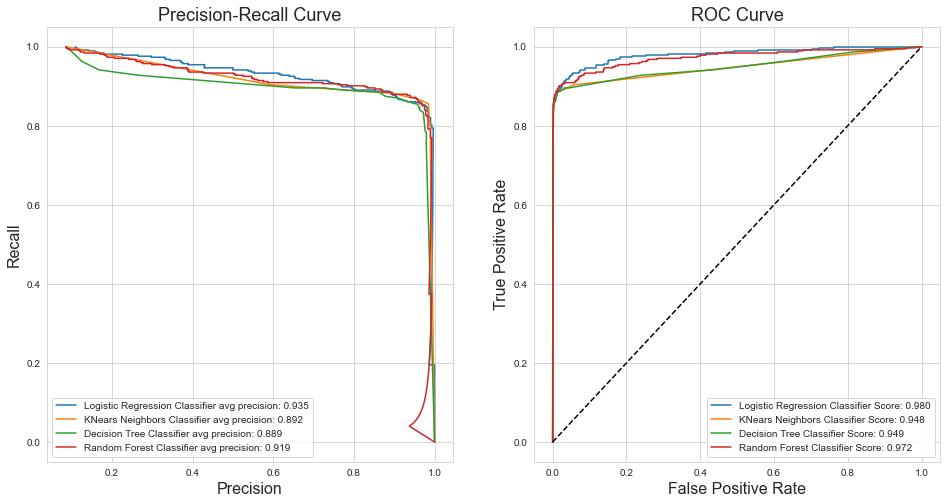

Plot for test results


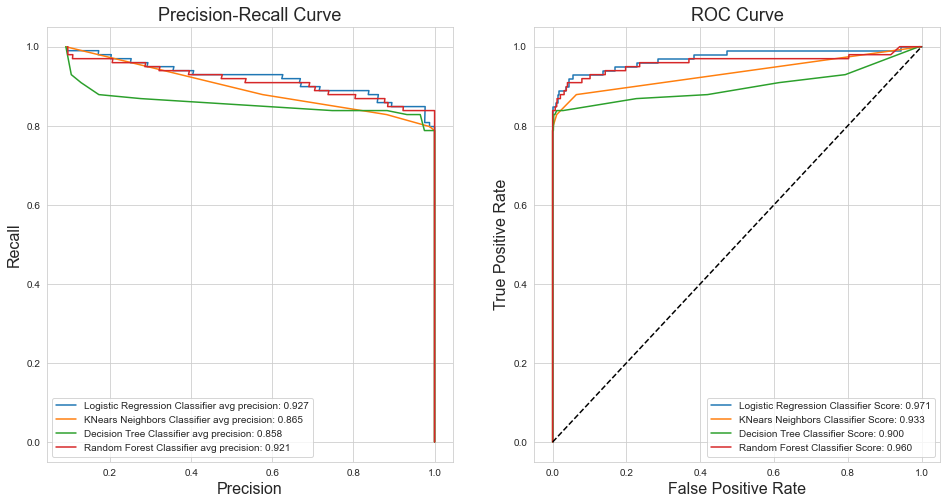

[LogisticRegression(C=0.1, max_iter=10000, random_state=38, solver='liblinear'),
 KNeighborsClassifier(n_neighbors=7),
 DecisionTreeClassifier(max_depth=4, min_samples_leaf=5, random_state=38),
 RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)]

In [20]:
### Experiment 1b: PCA applied on Baseline case
# 4.7 Apply pca for first 10 components to reduce dimensions
# and then train model with the new data

X_train_pca, X_test_pca = select_PCA(X_train, X_test)

print("\n************* PCA applied on Baseline case **************")
train_test(X_train_pca, y_train, X_test_pca, y_test)


************* Baseline adjusted for class weight **************
Initial evaluate training model
Classifiers:  LogisticRegression has a training accuracy score of 98.0 %
Classifiers:  KNeighborsClassifier has a training accuracy score of 98.0 %
Classifiers:  DecisionTreeClassifier has a training accuracy score of 97.0 %
Classifiers:  RandomForestClassifier has a training accuracy score of 99.0 %
Best fit parameter for Log regression LogisticRegression(C=0.01, class_weight={0: 1, 1: 10.71}, max_iter=10000,
                   random_state=38, solver='sag')
Elapsed time 14.36 s

Best fit parameter for KNN KNeighborsClassifier(n_neighbors=3)
Effective metric: euclidean
Elapsed time 18.25 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=2, min_samples_leaf=2, random_state=38)
Elapsed time 16.37 s

Best fit parameter for Random Forest: RandomForestClassifier(class_weight={0: 1, 1: 10.71}, max_

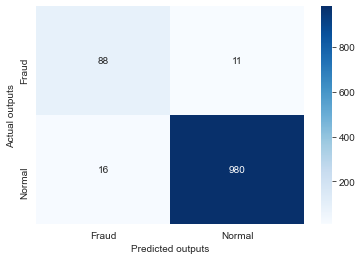


Predict model: KNeighborsClassifier(n_neighbors=3)

Training result:
              precision    recall  f1-score   support

           1       0.97      0.87      0.92       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.98      0.93      0.95      4378
weighted avg       0.99      0.99      0.99      4378

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.85      0.92        99
           0       0.99      1.00      0.99       996

    accuracy                           0.99      1095
   macro avg       0.99      0.92      0.96      1095
weighted avg       0.99      0.99      0.99      1095

Confusion matrix: KNeighborsClassifier(n_neighbors=3)


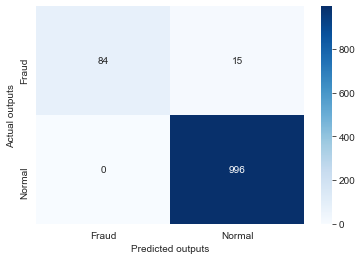


Predict model: DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=2, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.80      0.83      0.82       374
           0       0.98      0.98      0.98      4004

    accuracy                           0.97      4378
   macro avg       0.89      0.91      0.90      4378
weighted avg       0.97      0.97      0.97      4378

Testing result:
              precision    recall  f1-score   support

           1       0.80      0.87      0.83        99
           0       0.99      0.98      0.98       996

    accuracy                           0.97      1095
   macro avg       0.90      0.92      0.91      1095
weighted avg       0.97      0.97      0.97      1095

Confusion matrix: DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=2, min_samples_leaf=2,

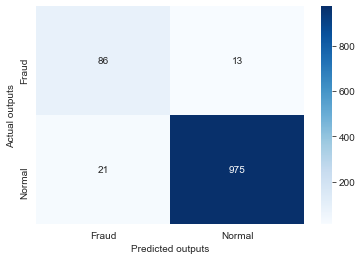


Predict model: RandomForestClassifier(class_weight={0: 1, 1: 10.71}, max_depth=5,
                       min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.98      0.86      0.92       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.98      0.93      0.95      4378
weighted avg       0.99      0.99      0.99      4378

Testing result:
              precision    recall  f1-score   support

           1       0.99      0.84      0.91        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.99      0.92      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(class_weight={0: 1, 1: 10.71}, max_depth=5,
                       min_samples_leaf=2, random_state=38)


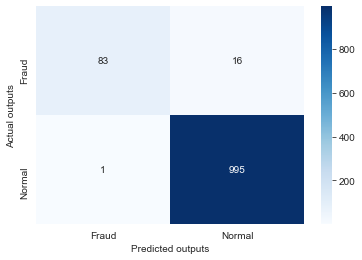

Plot for training results


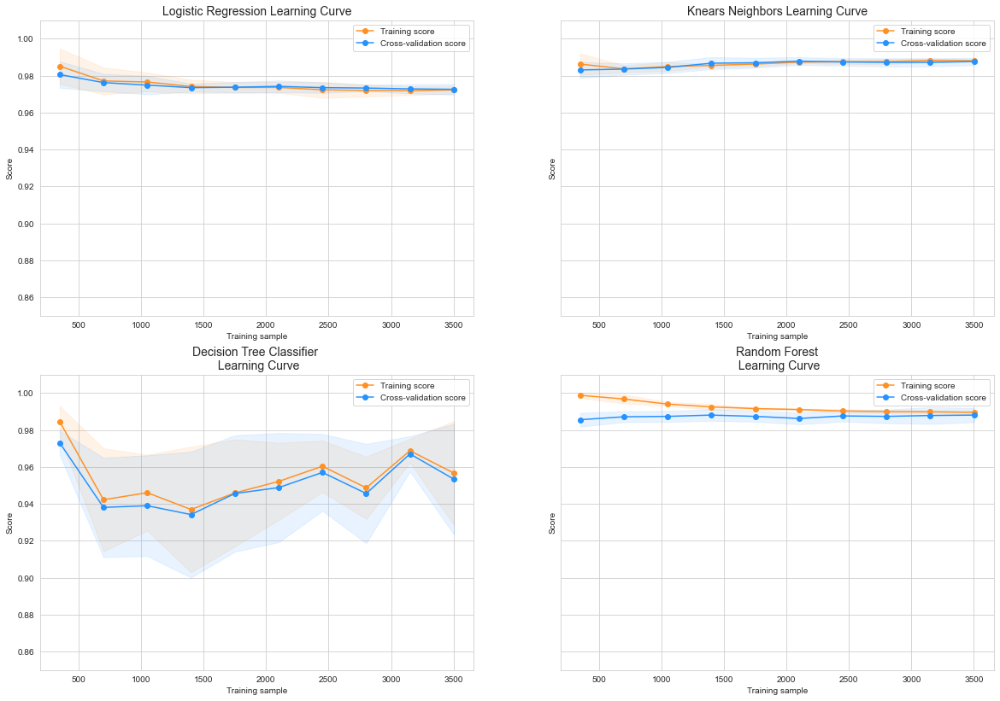

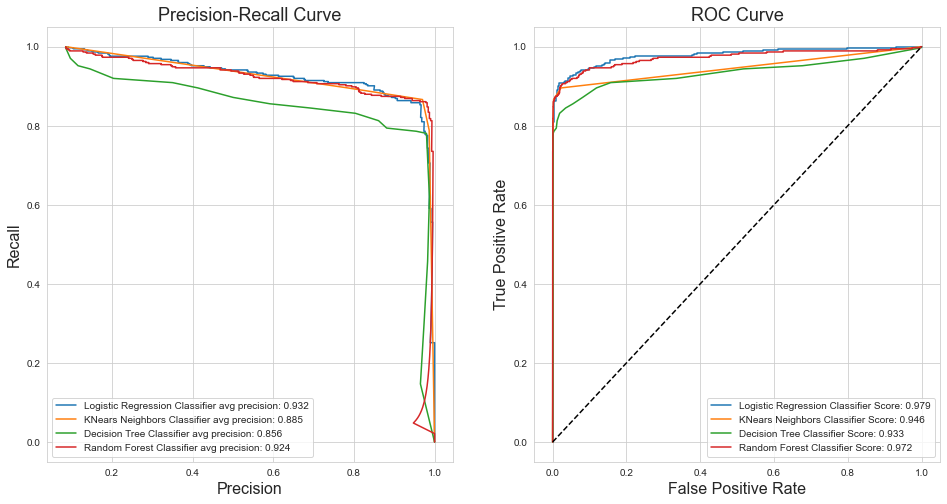

Plot for test results


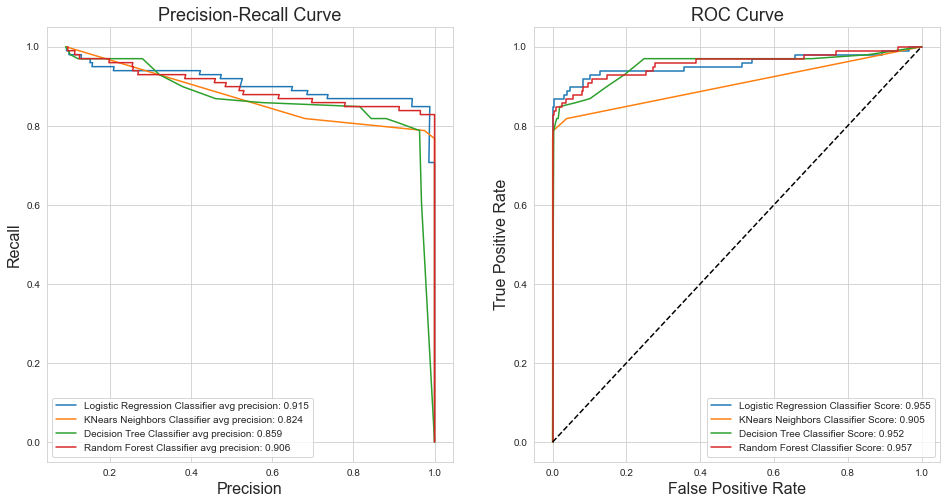

In [21]:
""" Step 5: Improve model  with class weight"""

### Experiment 2a: Adjust class weight on base line

CLASS_WEIGHT = {0:1,1:CLASS_WEIGHT}

# 5.1 Train model
print("\n************* Baseline adjusted for class weight **************")
print("Initial evaluate training model")
cross_validate(X_train, y_train)

# 5.2 Improve model, avoid overfitting and find optimal hyperparameter by applying GridSearchCV
# Evaluate model and get result
log_reg1, knn1, tree_clf1, rf1 = train_test(X_train, y_train, X_test, y_test, class_weight=CLASS_WEIGHT)

X_train_pca.shape: (4378, 10)

************* PCA applied on Baseline case adjusted class_weight**************
Best fit parameter for Log regression LogisticRegression(C=0.01, class_weight={0: 1, 1: 10.71}, max_iter=10000,
                   random_state=38, solver='sag')
Elapsed time 2.19 s

Best fit parameter for KNN KNeighborsClassifier(n_neighbors=7)
Effective metric: euclidean
Elapsed time 6.66 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=3, min_samples_leaf=2, random_state=38)
Elapsed time 5.19 s

Best fit parameter for Random Forest: RandomForestClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=5, min_samples_leaf=2, random_state=38)
Elapsed time 123.65 s

Predict model: LogisticRegression(C=0.01, class_weight={0: 1, 1: 10.71}, max_iter=10000,
                   random_state=38, solver='sag')

Training result:
              precisio

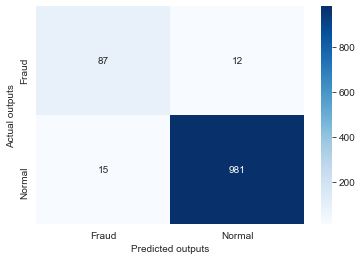


Predict model: KNeighborsClassifier(n_neighbors=7)

Training result:
              precision    recall  f1-score   support

           1       0.98      0.86      0.92       374
           0       0.99      1.00      0.99      4004

    accuracy                           0.99      4378
   macro avg       0.99      0.93      0.95      4378
weighted avg       0.99      0.99      0.99      4378

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.84      0.91        99
           0       0.98      1.00      0.99       996

    accuracy                           0.99      1095
   macro avg       0.99      0.92      0.95      1095
weighted avg       0.99      0.99      0.98      1095

Confusion matrix: KNeighborsClassifier(n_neighbors=7)


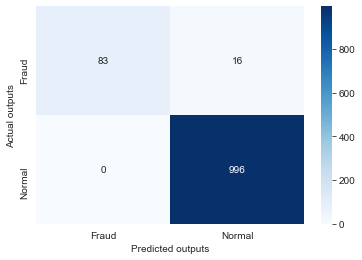


Predict model: DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=3, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.86      0.88      0.87       374
           0       0.99      0.99      0.99      4004

    accuracy                           0.98      4378
   macro avg       0.92      0.93      0.93      4378
weighted avg       0.98      0.98      0.98      4378

Testing result:
              precision    recall  f1-score   support

           1       0.94      0.84      0.89        99
           0       0.98      0.99      0.99       996

    accuracy                           0.98      1095
   macro avg       0.96      0.92      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=3, min_samples_leaf=2,

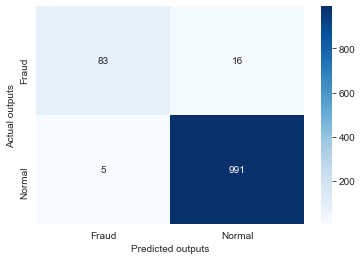


Predict model: RandomForestClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=5, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.93      0.88      0.91       374
           0       0.99      0.99      0.99      4004

    accuracy                           0.98      4378
   macro avg       0.96      0.94      0.95      4378
weighted avg       0.98      0.98      0.98      4378

Testing result:
              precision    recall  f1-score   support

           1       0.97      0.85      0.90        99
           0       0.99      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.98      0.92      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                       max_depth=5, min_samples_leaf=2,

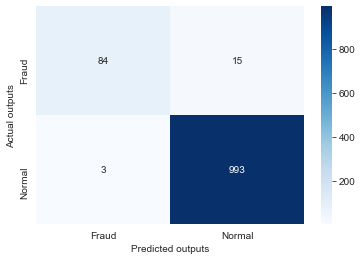

Plot for training results


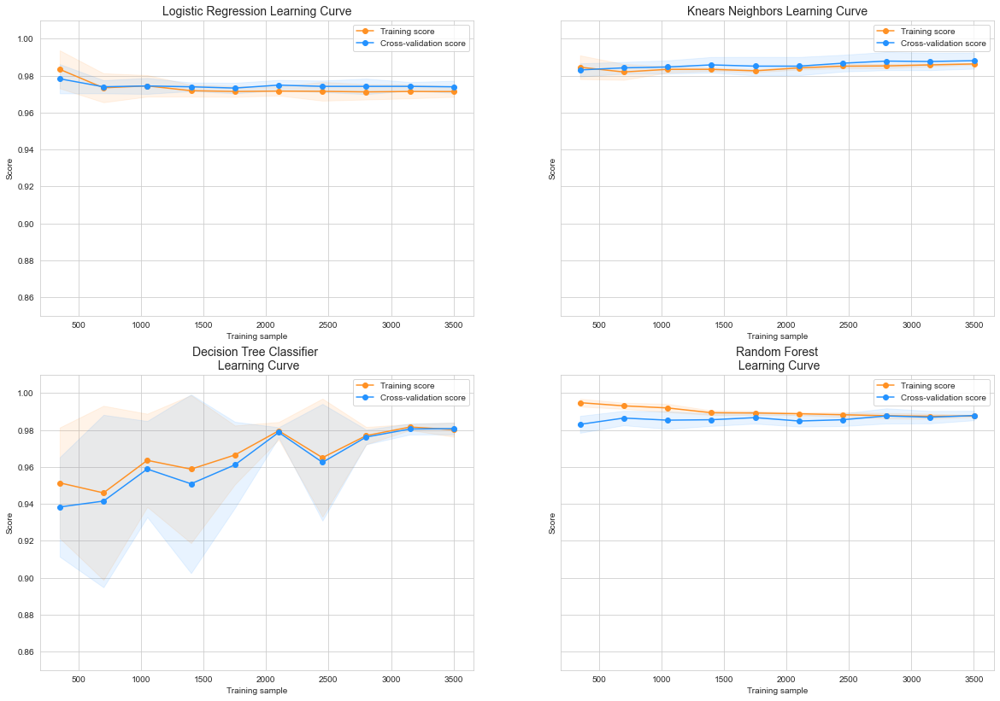

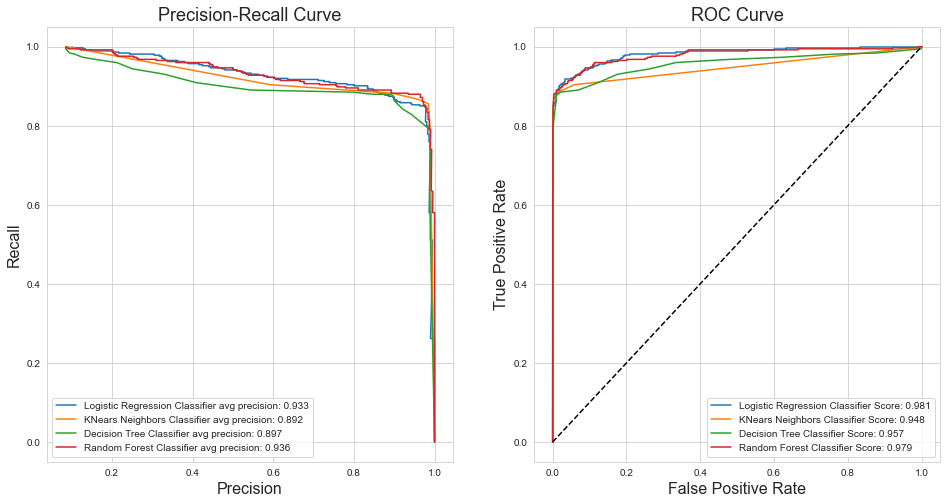

Plot for test results


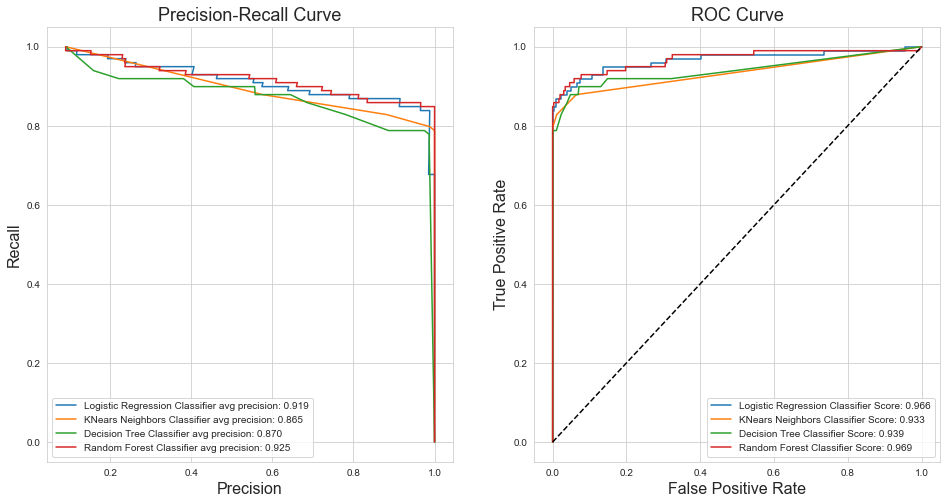

[LogisticRegression(C=0.01, class_weight={0: 1, 1: 10.71}, max_iter=10000,
                    random_state=38, solver='sag'),
 KNeighborsClassifier(n_neighbors=7),
 DecisionTreeClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                        max_depth=3, min_samples_leaf=2, random_state=38),
 RandomForestClassifier(class_weight={0: 1, 1: 10.71}, criterion='entropy',
                        max_depth=5, min_samples_leaf=2, random_state=38)]

In [22]:
# Experiment 2b: PCA
# 5.3 Apply pca for first 10 components to reduce dimension

X_train_pca, X_test_pca = select_PCA(X_train, X_test)

# Evaluate model and get result
print("\n************* PCA applied on Baseline case adjusted class_weight**************")
train_test(X_train_pca, y_train, X_test_pca, y_test, class_weight=CLASS_WEIGHT)


************* Undersampling - Near Miss**************
Initial evaluate training model
Classifiers:  LogisticRegression has a training accuracy score of 89.0 %
Classifiers:  KNeighborsClassifier has a training accuracy score of 88.0 %
Classifiers:  DecisionTreeClassifier has a training accuracy score of 82.0 %
Classifiers:  RandomForestClassifier has a training accuracy score of 89.0 %
Best fit parameter for Log regression LogisticRegression(C=0.01, max_iter=10000, random_state=38, solver='sag')
Elapsed time 3.84 s

Best fit parameter for KNN KNeighborsClassifier(metric='manhattan', n_neighbors=6)
Effective metric: manhattan
Elapsed time 1.49 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(max_depth=3, min_samples_leaf=6, random_state=38)
Elapsed time 2.71 s

Best fit parameter for Random Forest: RandomForestClassifier(max_depth=3, min_samples_leaf=2, random_state=38)
Elapsed time 55.33 s

Predict model: LogisticRegression(C=0.01, max_iter=10000, random_state=38, solver

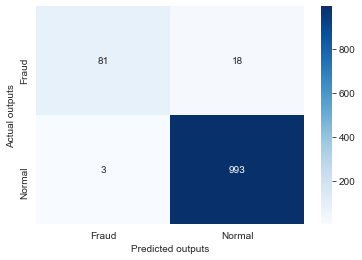


Predict model: KNeighborsClassifier(metric='manhattan', n_neighbors=6)

Training result:
              precision    recall  f1-score   support

           1       0.96      0.84      0.90       374
           0       0.86      0.97      0.91       374

    accuracy                           0.90       748
   macro avg       0.91      0.90      0.90       748
weighted avg       0.91      0.90      0.90       748

Testing result:
              precision    recall  f1-score   support

           1       0.99      0.84      0.91        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.99      0.92      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: KNeighborsClassifier(metric='manhattan', n_neighbors=6)


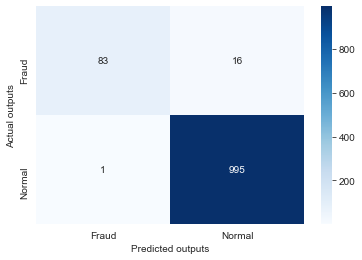


Predict model: DecisionTreeClassifier(max_depth=3, min_samples_leaf=6, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.96      0.83      0.89       374
           0       0.85      0.97      0.90       374

    accuracy                           0.90       748
   macro avg       0.91      0.90      0.90       748
weighted avg       0.91      0.90      0.90       748

Testing result:
              precision    recall  f1-score   support

           1       0.92      0.82      0.87        99
           0       0.98      0.99      0.99       996

    accuracy                           0.98      1095
   macro avg       0.95      0.91      0.93      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: DecisionTreeClassifier(max_depth=3, min_samples_leaf=6, random_state=38)


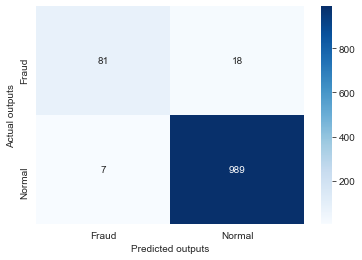


Predict model: RandomForestClassifier(max_depth=3, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.99      0.84      0.91       374
           0       0.86      0.99      0.92       374

    accuracy                           0.92       748
   macro avg       0.93      0.92      0.92       748
weighted avg       0.93      0.92      0.92       748

Testing result:
              precision    recall  f1-score   support

           1       0.96      0.83      0.89        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.97      0.91      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(max_depth=3, min_samples_leaf=2, random_state=38)


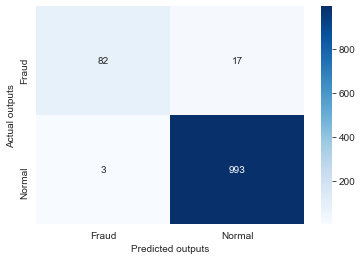

Plot for training results


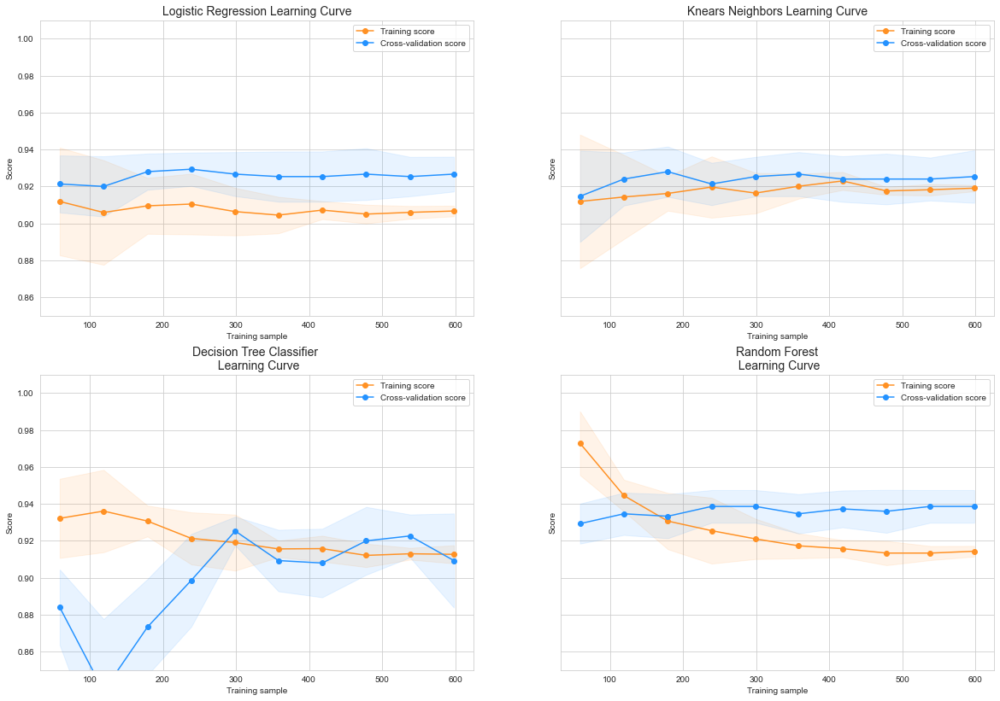

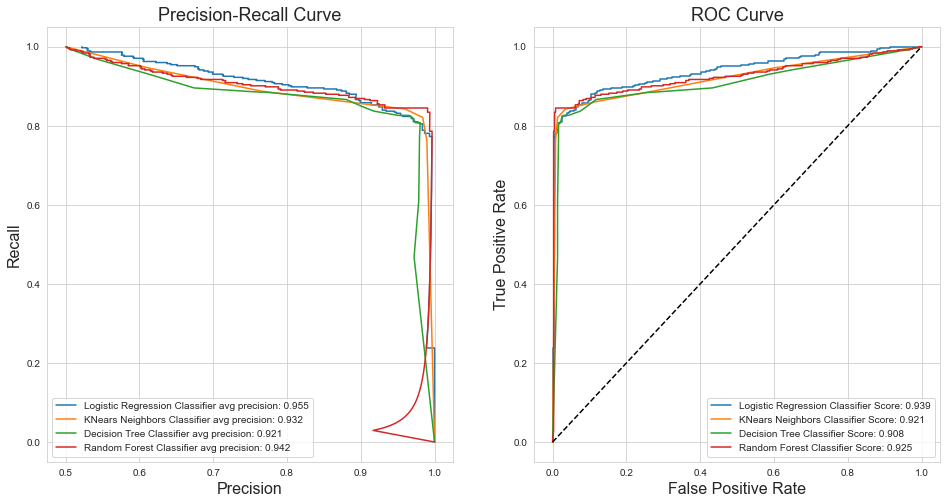

Plot for test results


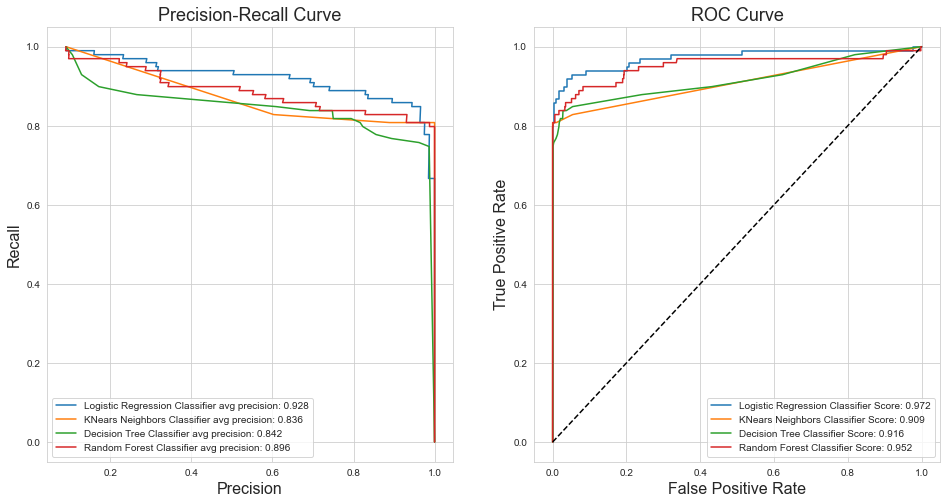

In [23]:
""" Step 6: Improve model  with Sampling method"""

### Experiment 3a: Undersampling - NearMiss

# 6.1 Train model
print("\n************* Undersampling - Near Miss**************")
print("Initial evaluate training model")
cross_validate(X_train_nm, y_train_nm)

# 6.2 Improve model, avoid overfitting and find optimal hyperparameter by applying GridSearchCV
log_reg_nm, knn_nm, tree_clf_nm, rf_nm = train_test(X_train_nm, y_train_nm, X_test, y_test)

X_train_pca.shape: (748, 10)

************* PCA applied on Undersampling **************
Best fit parameter for Log regression LogisticRegression(C=0.01, max_iter=10000, random_state=38, solver='sag')
Elapsed time 1.46 s

Best fit parameter for KNN KNeighborsClassifier(n_neighbors=4)
Effective metric: euclidean
Elapsed time 0.96 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_leaf=2,
                       random_state=38)
Elapsed time 0.84 s

Best fit parameter for Random Forest: RandomForestClassifier(criterion='entropy', max_depth=2, min_samples_leaf=2,
                       random_state=38)
Elapsed time 46.17 s

Predict model: LogisticRegression(C=0.01, max_iter=10000, random_state=38, solver='sag')

Training result:
              precision    recall  f1-score   support

           1       0.96      0.83      0.89       374
           0       0.85      0.97      0.90       374

    accuracy                           0.90

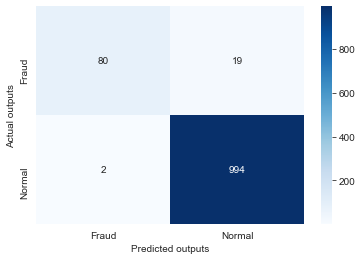


Predict model: KNeighborsClassifier(n_neighbors=4)

Training result:
              precision    recall  f1-score   support

           1       0.93      0.84      0.88       374
           0       0.85      0.93      0.89       374

    accuracy                           0.89       748
   macro avg       0.89      0.89      0.89       748
weighted avg       0.89      0.89      0.89       748

Testing result:
              precision    recall  f1-score   support

           1       1.00      0.83      0.91        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.99      0.91      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: KNeighborsClassifier(n_neighbors=4)


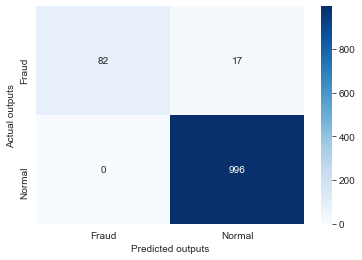


Predict model: DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_leaf=2,
                       random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.90      0.84      0.87       374
           0       0.85      0.91      0.88       374

    accuracy                           0.88       748
   macro avg       0.88      0.88      0.88       748
weighted avg       0.88      0.88      0.88       748

Testing result:
              precision    recall  f1-score   support

           1       0.98      0.83      0.90        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.98      0.91      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_leaf=2,
                       random_state=38)


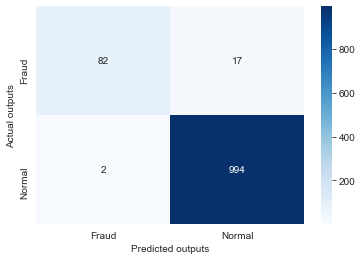


Predict model: RandomForestClassifier(criterion='entropy', max_depth=2, min_samples_leaf=2,
                       random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.93      0.84      0.88       374
           0       0.86      0.94      0.89       374

    accuracy                           0.89       748
   macro avg       0.89      0.89      0.89       748
weighted avg       0.89      0.89      0.89       748

Testing result:
              precision    recall  f1-score   support

           1       0.98      0.83      0.90        99
           0       0.98      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.98      0.91      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(criterion='entropy', max_depth=2, min_samples_leaf=2,
                       random_state=38)


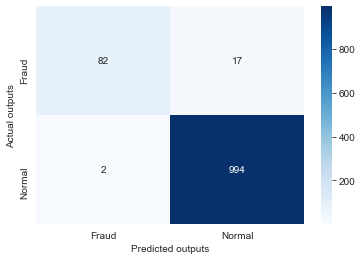

Plot for training results


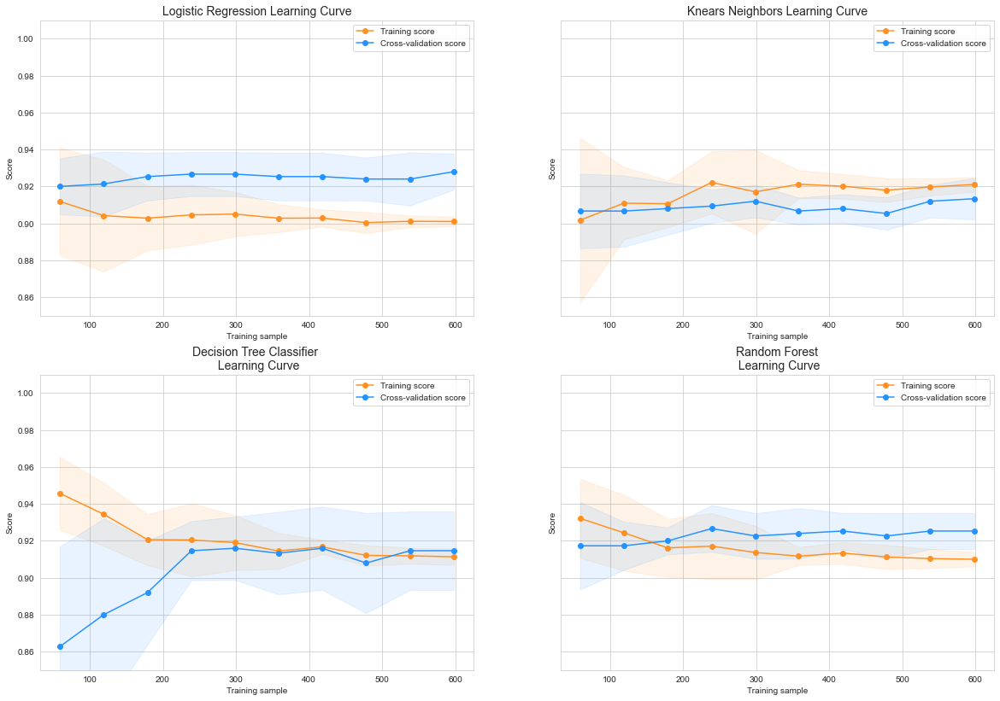

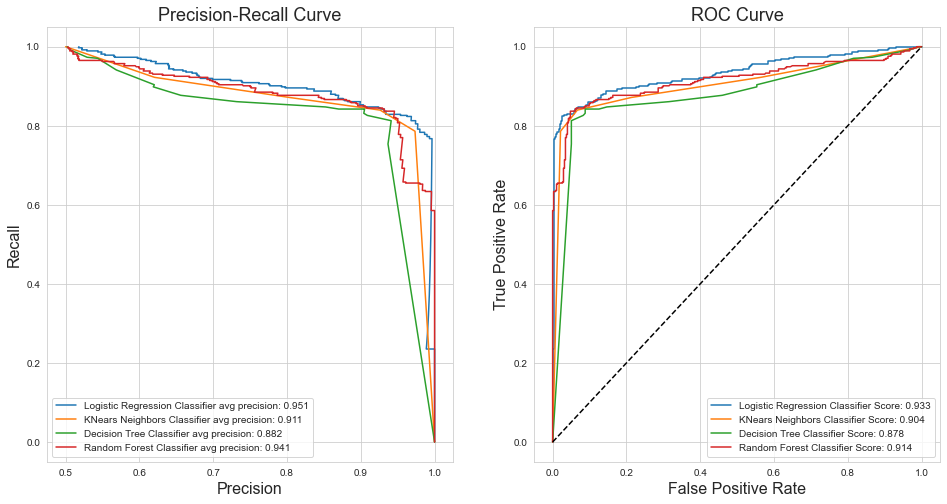

Plot for test results


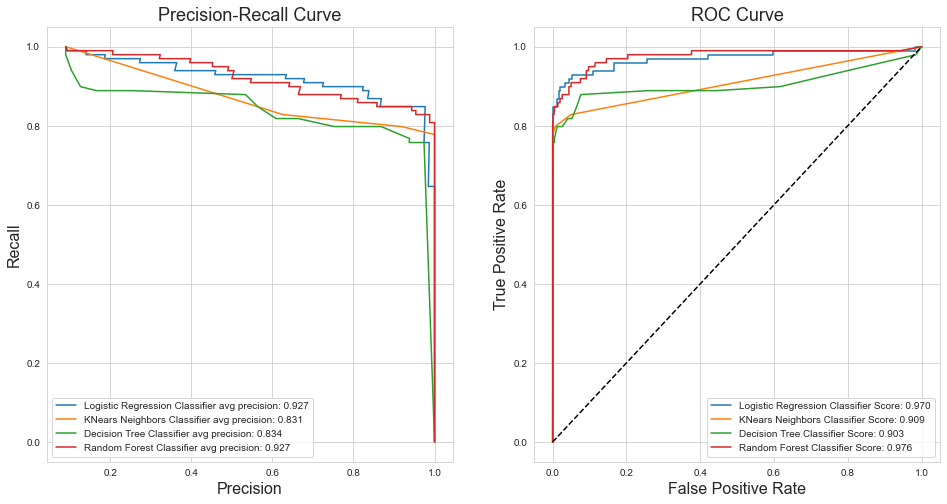

[LogisticRegression(C=0.01, max_iter=10000, random_state=38, solver='sag'),
 KNeighborsClassifier(n_neighbors=4),
 DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_leaf=2,
                        random_state=38),
 RandomForestClassifier(criterion='entropy', max_depth=2, min_samples_leaf=2,
                        random_state=38)]

In [24]:
### Experiment 3b: PCA on Undersampling
# 6.3 Apply pca for first 10 components 

X_train_pca, X_test_pca = select_PCA(X_train_nm, X_test)
print("\n************* PCA applied on Undersampling **************")
# Evaluate model and get result
train_test(X_train_pca, y_train_nm, X_test_pca, y_test)


************* Oversampling - SMOTE**************
Initial evaluate training model
Classifiers:  LogisticRegression has a training accuracy score of 95.0 %
Classifiers:  KNeighborsClassifier has a training accuracy score of 98.0 %
Classifiers:  DecisionTreeClassifier has a training accuracy score of 97.0 %
Classifiers:  RandomForestClassifier has a training accuracy score of 99.0 %
Best fit parameter for Log regression LogisticRegression(C=100, max_iter=10000, random_state=38, solver='liblinear')
Elapsed time 21.49 s

Best fit parameter for KNN KNeighborsClassifier(metric='manhattan', n_neighbors=2)
Effective metric: manhattan
Elapsed time 39.50 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(max_depth=5, min_samples_leaf=2, random_state=38)
Elapsed time 19.43 s

Best fit parameter for Random Forest: RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)
Elapsed time 272.01 s

Predict model: LogisticRegression(C=100, max_iter=10000, random_state=38, sol

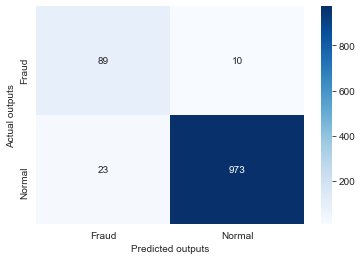


Predict model: KNeighborsClassifier(metric='manhattan', n_neighbors=2)

Training result:
              precision    recall  f1-score   support

           1       0.99      1.00      0.99      4004
           0       1.00      0.99      0.99      4004

    accuracy                           0.99      8008
   macro avg       0.99      0.99      0.99      8008
weighted avg       0.99      0.99      0.99      8008

Testing result:
              precision    recall  f1-score   support

           1       0.89      0.85      0.87        99
           0       0.99      0.99      0.99       996

    accuracy                           0.98      1095
   macro avg       0.94      0.92      0.93      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: KNeighborsClassifier(metric='manhattan', n_neighbors=2)


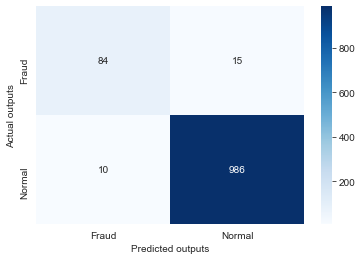


Predict model: DecisionTreeClassifier(max_depth=5, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.97      0.93      0.95      4004
           0       0.93      0.97      0.95      4004

    accuracy                           0.95      8008
   macro avg       0.95      0.95      0.95      8008
weighted avg       0.95      0.95      0.95      8008

Testing result:
              precision    recall  f1-score   support

           1       0.84      0.85      0.84        99
           0       0.98      0.98      0.98       996

    accuracy                           0.97      1095
   macro avg       0.91      0.92      0.91      1095
weighted avg       0.97      0.97      0.97      1095

Confusion matrix: DecisionTreeClassifier(max_depth=5, min_samples_leaf=2, random_state=38)


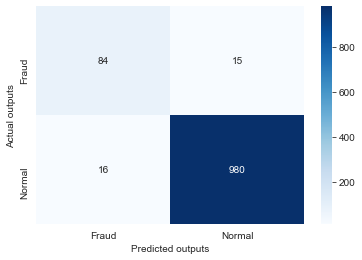


Predict model: RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.99      0.90      0.94      4004
           0       0.91      1.00      0.95      4004

    accuracy                           0.95      8008
   macro avg       0.95      0.95      0.95      8008
weighted avg       0.95      0.95      0.95      8008

Testing result:
              precision    recall  f1-score   support

           1       0.98      0.85      0.91        99
           0       0.99      1.00      0.99       996

    accuracy                           0.98      1095
   macro avg       0.98      0.92      0.95      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(max_depth=5, min_samples_leaf=2, random_state=38)


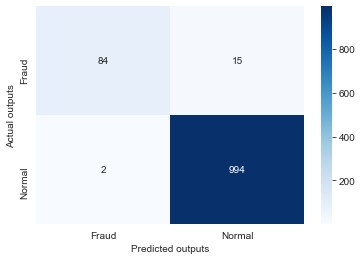

Plot for training results


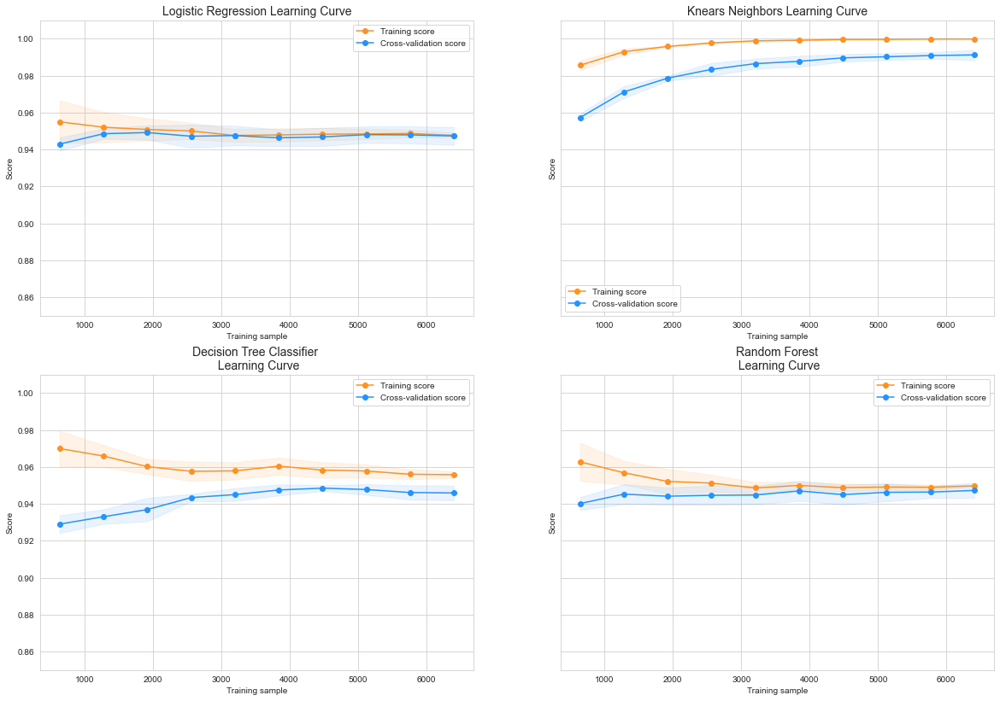

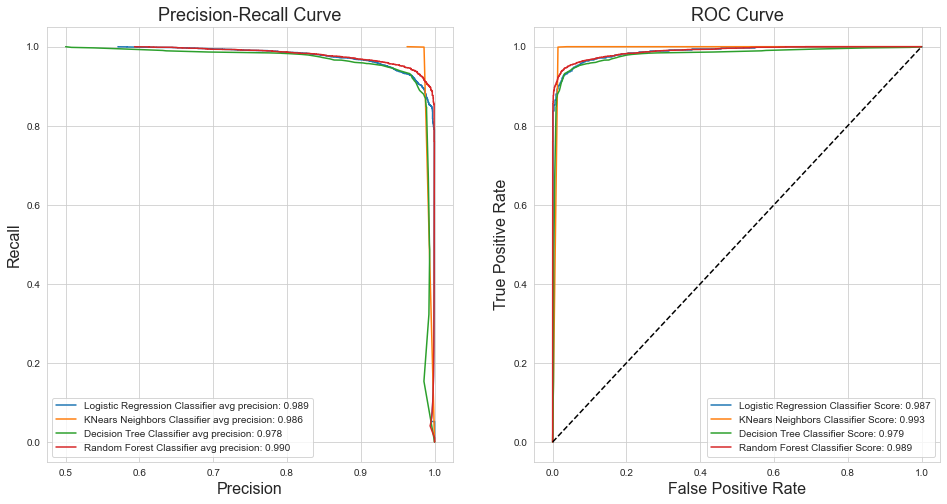

Plot for test results


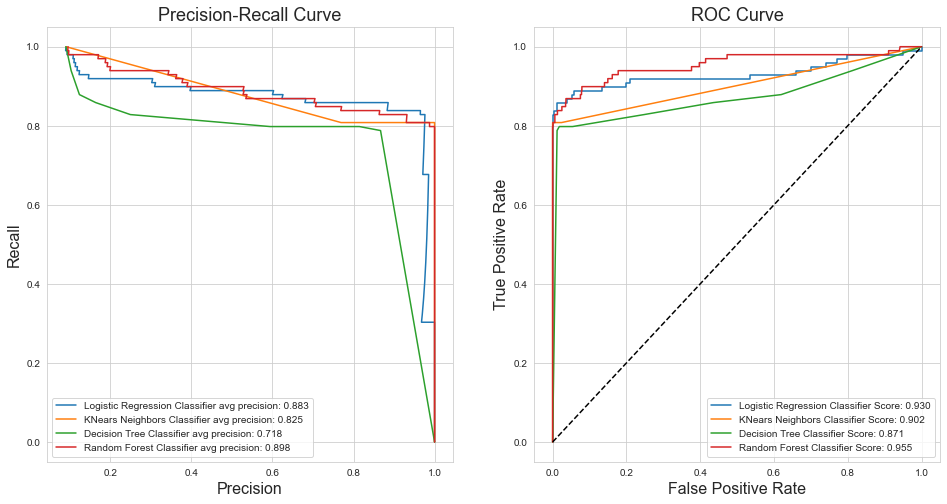

In [25]:
# Experiment 4a: Oversampling -SMOTE

# 6.4 Train model
print("\n************* Oversampling - SMOTE**************")
print("Initial evaluate training model")
cross_validate(X_train_sm, y_train_sm)

# 6.5 Improve model, avoid overfitting and find optimal hyperparameter by applying GridSearchCV
# Evaluate model and get result
log_reg_sm, knn_sm, tree_clf_sm, rf_sm = train_test(X_train_sm, y_train_sm, X_test, y_test)

X_train_pca.shape: (8008, 10)

************* PCA applied on Oversampling **************
Best fit parameter for Log regression LogisticRegression(C=100, max_iter=10000, random_state=38, solver='liblinear')
Elapsed time 25.04 s

Best fit parameter for KNN KNeighborsClassifier(n_neighbors=2)
Effective metric: euclidean
Elapsed time 14.73 s

Best fit parameter for Decision Tree: DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_leaf=5,
                       random_state=38)
Elapsed time 11.20 s

Best fit parameter for Random Forest: RandomForestClassifier(max_depth=5, min_samples_leaf=4, random_state=38)
Elapsed time 231.07 s

Predict model: LogisticRegression(C=100, max_iter=10000, random_state=38, solver='liblinear')

Training result:
              precision    recall  f1-score   support

           1       0.97      0.90      0.94      4004
           0       0.91      0.98      0.94      4004

    accuracy                           0.94      8008
   macro avg       

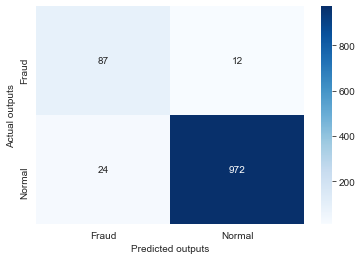


Predict model: KNeighborsClassifier(n_neighbors=2)

Training result:
              precision    recall  f1-score   support

           1       0.99      0.98      0.98      4004
           0       0.98      0.99      0.98      4004

    accuracy                           0.98      8008
   macro avg       0.98      0.98      0.98      8008
weighted avg       0.98      0.98      0.98      8008

Testing result:
              precision    recall  f1-score   support

           1       0.89      0.87      0.88        99
           0       0.99      0.99      0.99       996

    accuracy                           0.98      1095
   macro avg       0.94      0.93      0.93      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: KNeighborsClassifier(n_neighbors=2)


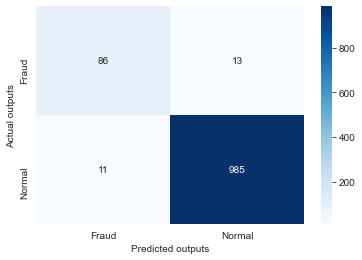


Predict model: DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_leaf=5,
                       random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.96      0.94      0.95      4004
           0       0.94      0.96      0.95      4004

    accuracy                           0.95      8008
   macro avg       0.95      0.95      0.95      8008
weighted avg       0.95      0.95      0.95      8008

Testing result:
              precision    recall  f1-score   support

           1       0.74      0.90      0.81        99
           0       0.99      0.97      0.98       996

    accuracy                           0.96      1095
   macro avg       0.86      0.93      0.89      1095
weighted avg       0.97      0.96      0.96      1095

Confusion matrix: DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_leaf=5,
                       random_state=38)


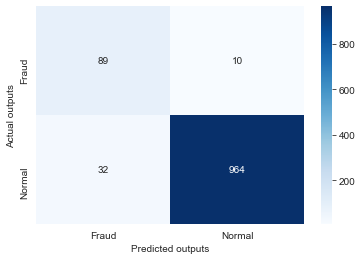


Predict model: RandomForestClassifier(max_depth=5, min_samples_leaf=4, random_state=38)

Training result:
              precision    recall  f1-score   support

           1       0.99      0.91      0.94      4004
           0       0.91      0.99      0.95      4004

    accuracy                           0.95      8008
   macro avg       0.95      0.95      0.95      8008
weighted avg       0.95      0.95      0.95      8008

Testing result:
              precision    recall  f1-score   support

           1       0.91      0.87      0.89        99
           0       0.99      0.99      0.99       996

    accuracy                           0.98      1095
   macro avg       0.95      0.93      0.94      1095
weighted avg       0.98      0.98      0.98      1095

Confusion matrix: RandomForestClassifier(max_depth=5, min_samples_leaf=4, random_state=38)


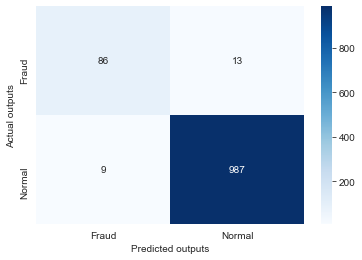

Plot for training results


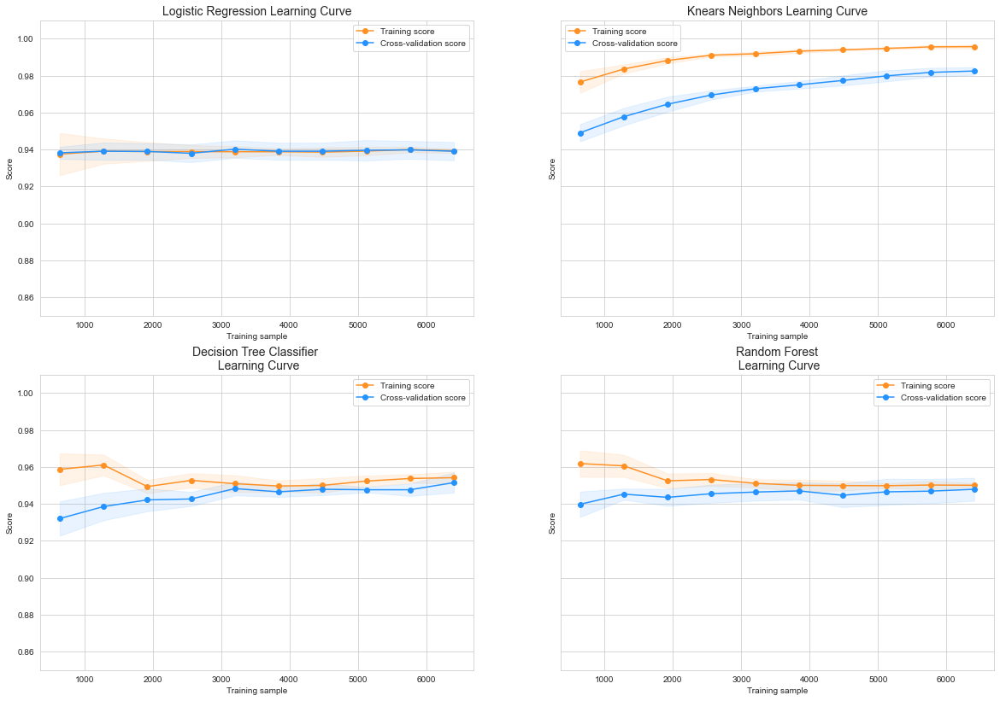

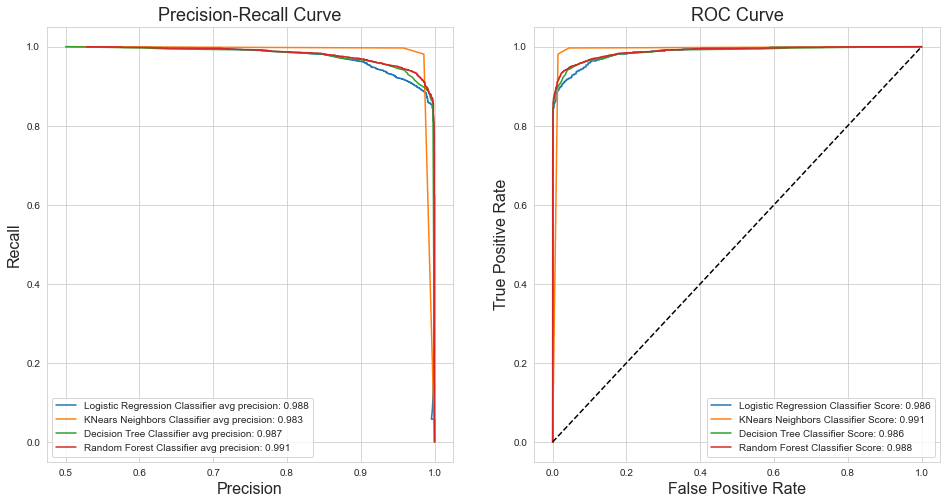

Plot for test results


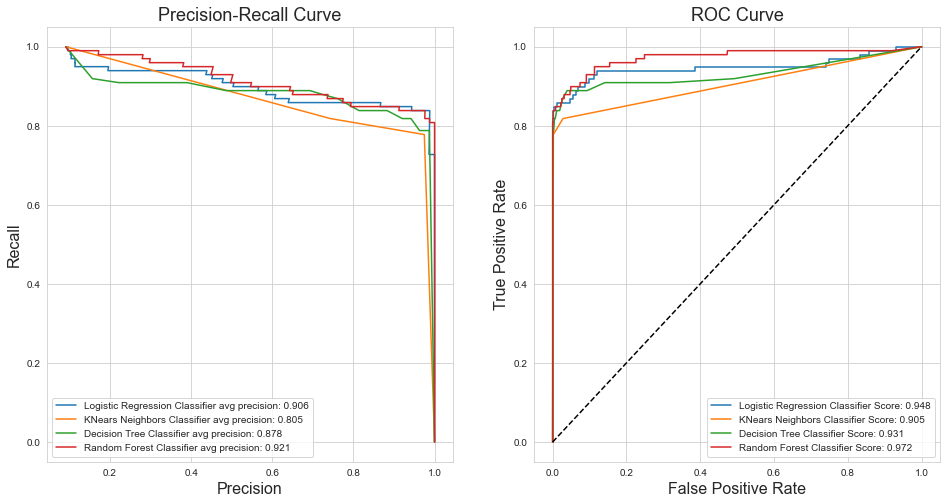

[LogisticRegression(C=100, max_iter=10000, random_state=38, solver='liblinear'),
 KNeighborsClassifier(n_neighbors=2),
 DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_leaf=5,
                        random_state=38),
 RandomForestClassifier(max_depth=5, min_samples_leaf=4, random_state=38)]

In [26]:
# Experiment 4b: PCA on Oversampling
# 6.6 Apply pca for first 10 components 

X_train_pca, X_test_pca = select_PCA(X_train_sm, X_test)

# Evaluate model and get result
print("\n************* PCA applied on Oversampling **************")
train_test(X_train_pca, y_train_sm, X_test_pca, y_test)

In [27]:
"""Step 7: Unsupervised learning models"""


'Step 7: Unsupervised learning models'

In [28]:
# Experiment 5:
# 7.1 Set up Unsupervised learning - Auto-Encoder
def autoencoder_model(X_train, y_train, X_test, y_test, val_size=0.2,
                         batch_size=25, epochs=80, RANDOM_STATE=38, learning_rate=1e-7):
    
    tensorflow.random.set_seed(12)  # for seeding
    
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=val_size, random_state=RANDOM_STATE, shuffle=True)

    # Get the X train for normal transaction
    X_train_normal = X_train[y_train == 0].values
    y_train_normal = y_train[y_train == 0]

    X_train_normal.shape
    
    print("Number transactions X_train_normal dataset: ", X_train.shape)
    print("Number transactions y_train_normal dataset: ", y_train.shape)
    print("Number transactions X_validation dataset: ", X_val.shape)
    print("Number transactions y_valudation dataset: ", y_val.shape)
    
    # Design model
    input_dim = X_train_normal.shape[1]
    encoding_dim = 14
    ## input layer
    input_layer = Input(shape=(input_dim, ))
    ## encoding part
    encoder = Dense(encoding_dim, activation="relu", 
                    activity_regularizer=regularizers.l2(learning_rate))(input_layer)
    encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
    ## decoding part
    decoder = Dense(int(encoding_dim / 2), activation='relu')(encoder)
    decoder = Dense(input_dim, activation='relu')(decoder)
    ## output layer
    autoencoder = Model(inputs=input_layer, outputs=decoder)
    
    autoencoder.summary()
    
    # Complile model
    autoencoder.compile(optimizer='adam', 
                        loss='mean_squared_error', 
                        metrics=['accuracy'])
    checkpointer = ModelCheckpoint(filepath="fraud_dection.h5",
                                   verbose=0,
                                   save_best_only=True)
    # fit in autoencoder X_train vs X_train (unsupervised)
    history = autoencoder.fit(X_train_normal, X_train_normal,
                        epochs=epochs,
                        batch_size=batch_size,
                        shuffle=True,
                        validation_data=(X_val, X_val),
                        verbose=1,
                        callbacks=[checkpointer]).history

    autoencoder = load_model('fraud_dection.h5')
    
    # Plot learning curve
    f, (ax1, ax2) = plt.subplots(2,1, figsize=(10,10), sharex=True)
    plt.suptitle('Learning curve', fontsize=18)
    
    # Loss learning curve
    ax1.set_title('Model Loss', fontsize=16)
    ax1.plot(history['loss'], 'o-', color="#ff9124", label='train loss')
    ax1.plot(history['val_loss'], 'o-', color="#2492ff", label='validation loss')
    ax1.set_xlabel('epoch')
    ax1.set_ylabel('loss')
    ax1.legend(loc="best")
    ax1.grid(True)
    
    # Accuracy learning curve
    ax2.set_title('Model Accuracy', fontsize=16)
    ax2.plot(history['accuracy'], 'o-', color="#ff9124", label='train accuracy')
    ax2.plot(history['val_accuracy'], 'o-', color="#2492ff", label='validation accuracy')
    ax2.set_xlabel('epoch')
    ax2.set_ylabel('accuracy')
    ax2.legend(loc="best")
    ax2.set_ylim([0.1,1])
    ax2.grid(True)
    plt.show()

    return autoencoder, X_train_normal, y_train_normal, X_val, y_val  

# Calc mse for X train
def calc_mse(autoencoder, X, y):
    pred = autoencoder.predict(X)
    score = np.sqrt(mean_squared_error(pred,X))
    return score

def predict(autoencoder, X_test, y_test, threshold):
    # Make a prediction
    predictions = autoencoder.predict(X_test)
    mse = np.mean(np.power(X_test - predictions, 2), axis=1)
    error_df = pd.DataFrame({'reconstruction_error': mse,
                            'true_class': y_test})    
    
    print(error_df.describe())

    # Plot ROC
    fpr, tpr, thres_roc = roc_curve(error_df.true_class, error_df.reconstruction_error)
    roc_auc = roc_auc_score(error_df.true_class, error_df.reconstruction_error, labels=[1,0])

    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, label='AUC = %0.3f'% roc_auc)
    plt.legend(loc='lower right')
    plt.plot([0,1],[0,1],'r--')
    plt.xlim([-0.001, 1])
    plt.ylim([0, 1.001])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()

    # Plot Precision and recall
    precision, recall, thres_pr = precision_recall_curve(error_df.true_class, error_df.reconstruction_error,  pos_label=1)
    plt.plot(precision, recall, label= 'Avg precision = {:0.3f}'.format(average_precision_score(error_df.true_class, error_df.reconstruction_error)))
    plt.title('Precision-Recall Curve')
    plt.xlabel('Precision')
    plt.ylabel('Recall')
    plt.legend(loc='best')
    plt.show()

    # Reconstruct error for fraud and normal transaction as threshold
    groups = error_df.groupby('true_class')
    fig, ax = plt.subplots()

    for name, group in groups:
        ax.plot(group.index, group.reconstruction_error, marker='o', ms=3.5, linestyle='',
                label= "Fraud" if name == 1 else "Normal")
    ax.hlines(threshold, ax.get_xlim()[0], ax.get_xlim()[1], colors="r", zorder=100, label='Threshold')
    ax.legend()
    plt.title("Reconstruction error for different classes")
    plt.ylabel("Reconstruction error")
    plt.xlabel("Data point index")
    plt.show()


    # Confusion matrix
    # Choose threshold fix: 5 pred_y = [1 if e > threshold_fixed else 0 for e in error_df.Reconstruction_error.values]
    LABELS = ["Fraud", "Normal"]
    y_pred = [1 if i > threshold else 0 for i in error_df.reconstruction_error.values]
    conf_matrix = confusion_matrix(error_df.true_class, y_pred, labels=[1,0])
    plt.figure(figsize=(8, 8))
    sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
    plt.title("Confusion matrix")
    plt.ylabel('Actual class')
    plt.xlabel('Predicted class')
    plt.show()

    # Report
    print(classification_report(error_df.true_class, y_pred, labels=[1,0]))

Number transactions X_train_normal dataset:  (3502, 29)
Number transactions y_train_normal dataset:  (3502,)
Number transactions X_validation dataset:  (876, 29)
Number transactions y_valudation dataset:  (876,)
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 29)]              0         
_________________________________________________________________
dense (Dense)                (None, 14)                420       
_________________________________________________________________
dense_1 (Dense)              (None, 7)                 105       
_________________________________________________________________
dense_2 (Dense)              (None, 7)                 56        
_________________________________________________________________
dense_3 (Dense)              (None, 29)                232       
Total params: 813
Trainable params: 813
Non-tra

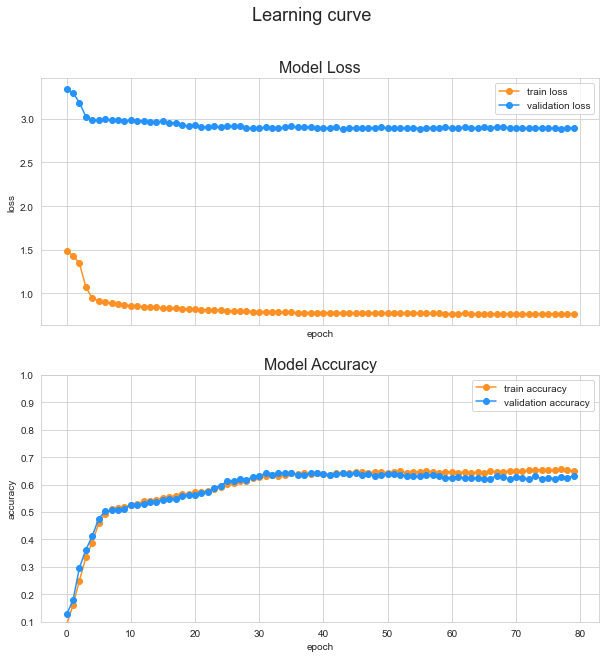

In [29]:
# 7.2 Experiment 5a: train model with batch size =25, learning rate = 0.001
autoencoder, X_train_normal, y_train_normal, X_val, y_val = autoencoder_model(X_train, y_train, X_test, y_test, batch_size=25, epochs=80, learning_rate=0.001)


******************Training result*********************
Normal transaction MSE in training set: 0.8778829336596955
Fraud transaction MSE in training set: 4.978444761080135
Threshold level: 3
       reconstruction_error   true_class
count           4378.000000  4378.000000
mean               2.804024     0.085427
std               12.715639     0.279548
min                0.070246     0.000000
25%                0.317497     0.000000
50%                0.507322     0.000000
75%                0.831877     0.000000
max              279.845605     1.000000


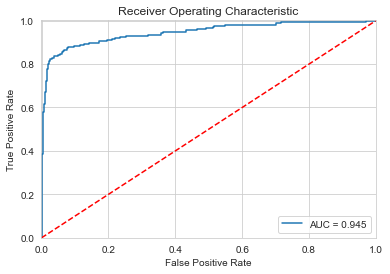

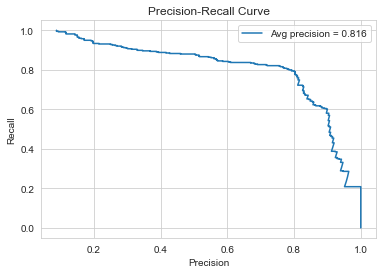

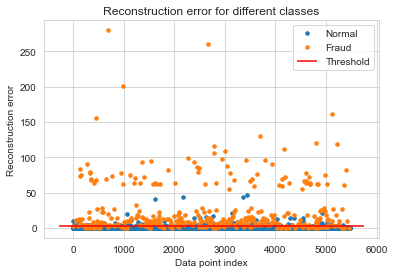

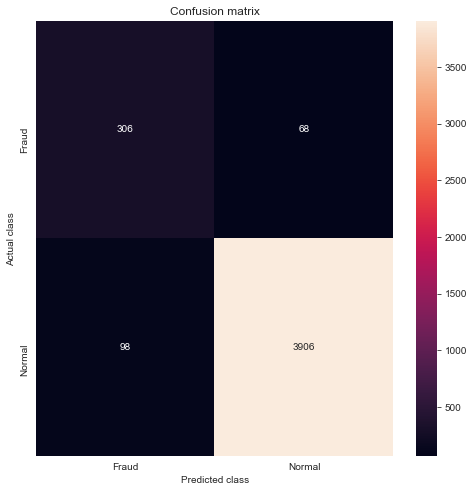

              precision    recall  f1-score   support

           1       0.76      0.82      0.79       374
           0       0.98      0.98      0.98      4004

    accuracy                           0.96      4378
   macro avg       0.87      0.90      0.88      4378
weighted avg       0.96      0.96      0.96      4378


******************Test result*********************
       reconstruction_error   true_class
count           1095.000000  1095.000000
mean               2.989854     0.090411
std               12.040410     0.286901
min                0.080161     0.000000
25%                0.309060     0.000000
50%                0.470706     0.000000
75%                0.806328     0.000000
max              123.054391     1.000000


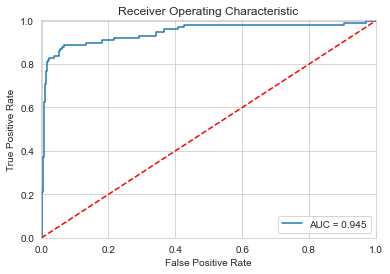

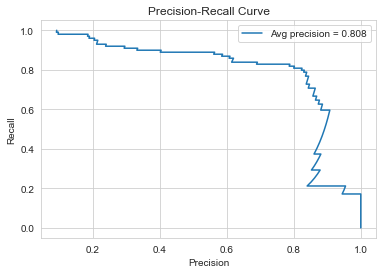

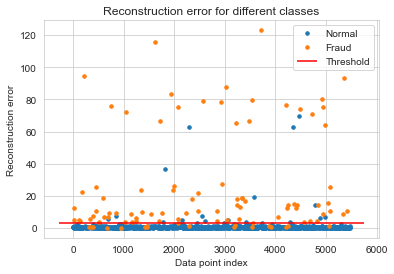

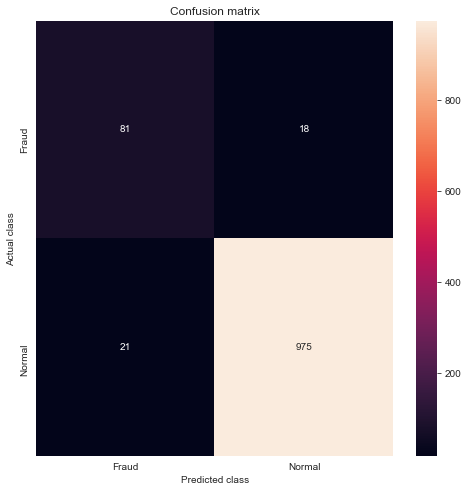

              precision    recall  f1-score   support

           1       0.79      0.82      0.81        99
           0       0.98      0.98      0.98       996

    accuracy                           0.96      1095
   macro avg       0.89      0.90      0.89      1095
weighted avg       0.96      0.96      0.96      1095



In [30]:
# 7.3 Experiment 5a: training results
THRESHOLD = 3

# Get training result
print("******************Training result*********************")

# Reconstruction error (MSE) of normal transaction
score = calc_mse(autoencoder, X_train_normal, y_train_normal)
print('Normal transaction MSE in training set:',score)

X_train_fraud = X_train[y_train==1].values
y_train_fraud = y_train[y_train==1]

# Reconstruction error (MSE) of fraud transaction
score_f = calc_mse(autoencoder, X_train_fraud, y_train_fraud)
print('Fraud transaction MSE in training set:',score_f)

# From these above 2 values, identify the threshold to detect abnomaly
# For any data point larger than threshold will be regard as fraud
print("Threshold level:", THRESHOLD)
predict(autoencoder, X_train, y_train, threshold=THRESHOLD)

# Testing
print("\n******************Test result*********************")
predict(autoencoder, X_test, y_test, threshold=THRESHOLD)

Number transactions X_train_normal dataset:  (3502, 29)
Number transactions y_train_normal dataset:  (3502,)
Number transactions X_validation dataset:  (876, 29)
Number transactions y_valudation dataset:  (876,)
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 29)]              0         
_________________________________________________________________
dense_4 (Dense)              (None, 14)                420       
_________________________________________________________________
dense_5 (Dense)              (None, 7)                 105       
_________________________________________________________________
dense_6 (Dense)              (None, 7)                 56        
_________________________________________________________________
dense_7 (Dense)              (None, 29)                232       
Total params: 813
Trainable params: 813
Non-t

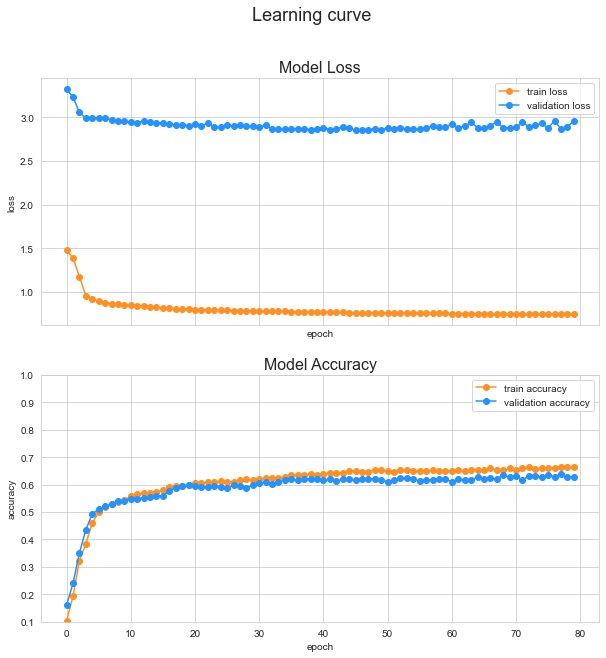

In [31]:
# 7.4 Experiment 5b: train model batch size 16 and learning rate = 0.001
autoencoder, X_train_normal, y_train_normal, X_val, y_val = autoencoder_model(X_train, y_train, X_test, y_test, batch_size=16, epochs=80, learning_rate=0.001)

******************Training result*********************
Normal transaction MSE in training set: 0.8667871817776217
Fraud transaction MSE in training set: 4.976019676748638
Threshold level: 3
       reconstruction_error   true_class
count           4378.000000  4378.000000
mean               2.784994     0.085427
std               12.729290     0.279548
min                0.053883     0.000000
25%                0.311182     0.000000
50%                0.491136     0.000000
75%                0.806655     0.000000
max              279.350506     1.000000


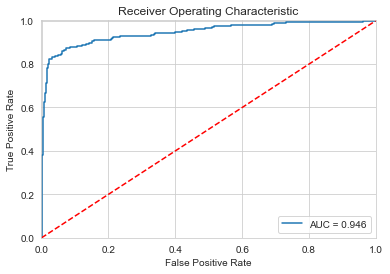

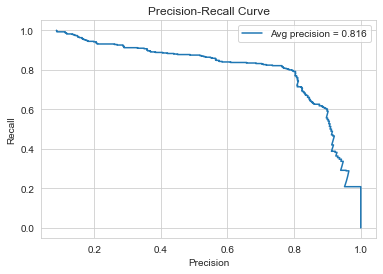

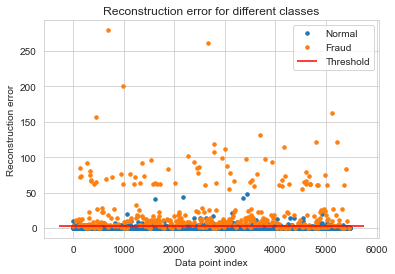

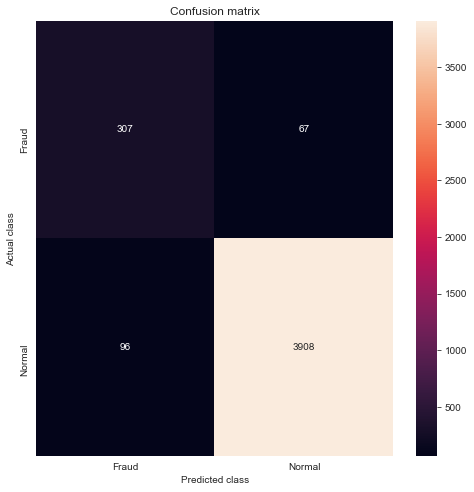

              precision    recall  f1-score   support

           1       0.76      0.82      0.79       374
           0       0.98      0.98      0.98      4004

    accuracy                           0.96      4378
   macro avg       0.87      0.90      0.88      4378
weighted avg       0.96      0.96      0.96      4378


******************Test result*********************
       reconstruction_error   true_class
count           1095.000000  1095.000000
mean               2.966597     0.090411
std               12.025960     0.286901
min                0.055941     0.000000
25%                0.296863     0.000000
50%                0.462505     0.000000
75%                0.780240     0.000000
max              125.302121     1.000000


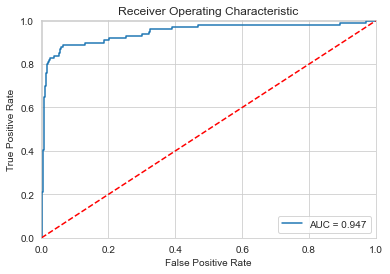

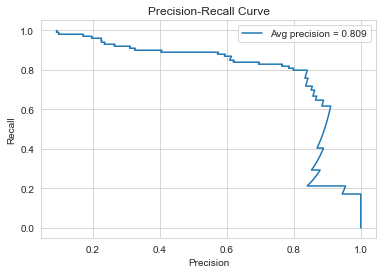

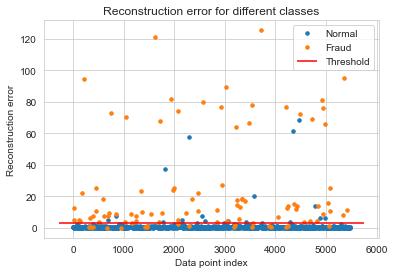

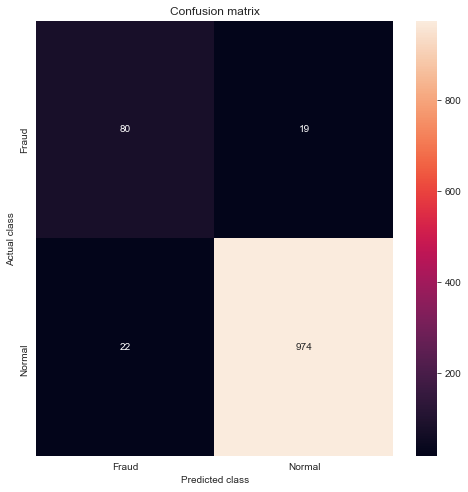

              precision    recall  f1-score   support

           1       0.78      0.81      0.80        99
           0       0.98      0.98      0.98       996

    accuracy                           0.96      1095
   macro avg       0.88      0.89      0.89      1095
weighted avg       0.96      0.96      0.96      1095



In [32]:
# 7.5 Experiment 5b: training results
THRESHOLD = 3

# Get training result
print("******************Training result*********************")

# Reconstruction error (MSE) of normal transaction
score = calc_mse(autoencoder, X_train_normal, y_train_normal)
print('Normal transaction MSE in training set:',score)

X_train_fraud = X_train[y_train==1].values
y_train_fraud = y_train[y_train==1]

# Reconstruction error (MSE) of fraud transaction
score_f = calc_mse(autoencoder, X_train_fraud, y_train_fraud)
print('Fraud transaction MSE in training set:',score_f)

# From these above 2 values, identify the threshold to detect abnomaly
# For any data point larger than threshold will be regard as fraud
print("Threshold level:", THRESHOLD)
predict(autoencoder, X_train, y_train, threshold=THRESHOLD)

# Testing
print("\n******************Test result*********************")
predict(autoencoder, X_test, y_test, threshold=THRESHOLD)

Number transactions X_train_normal dataset:  (3502, 29)
Number transactions y_train_normal dataset:  (3502,)
Number transactions X_validation dataset:  (876, 29)
Number transactions y_valudation dataset:  (876,)
Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 29)]              0         
_________________________________________________________________
dense_8 (Dense)              (None, 14)                420       
_________________________________________________________________
dense_9 (Dense)              (None, 7)                 105       
_________________________________________________________________
dense_10 (Dense)             (None, 7)                 56        
_________________________________________________________________
dense_11 (Dense)             (None, 29)                232       
Total params: 813
Trainable params: 813
Non-t

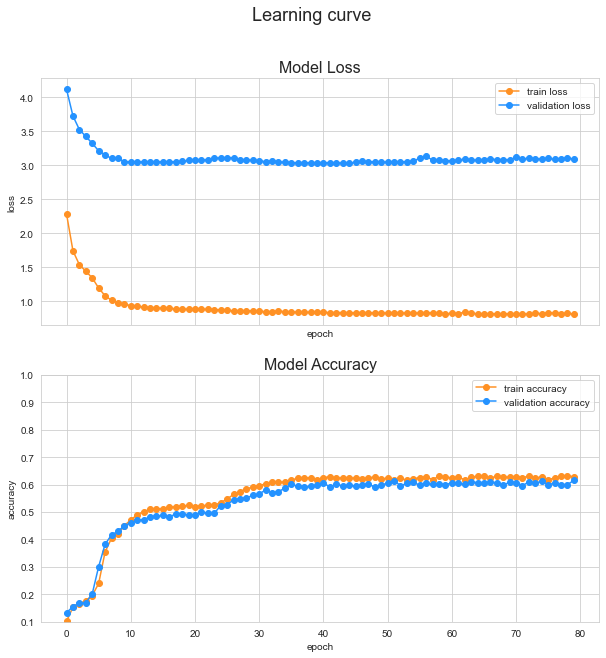

In [33]:
# 7.6 Experiment 5c: train model batch size 16 and learning rate = 0.1
autoencoder, X_train_normal, y_train_normal, X_val, y_val = autoencoder_model(X_train, y_train, X_test, y_test, batch_size=16, epochs=80, learning_rate=0.1)

******************Training result*********************
Normal transaction MSE in training set: 0.9038278885600561
Fraud transaction MSE in training set: 5.099904223812524
Threshold level: 3
       reconstruction_error   true_class
count           4378.000000  4378.000000
mean               2.950678     0.085427
std               13.211827     0.279548
min                0.106753     0.000000
25%                0.322348     0.000000
50%                0.550390     0.000000
75%                0.869042     0.000000
max              280.073181     1.000000


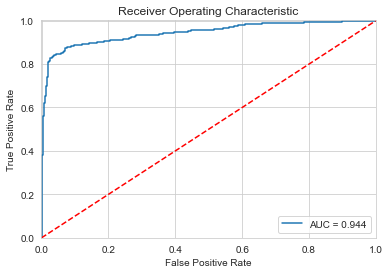

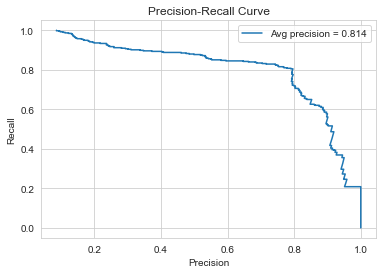

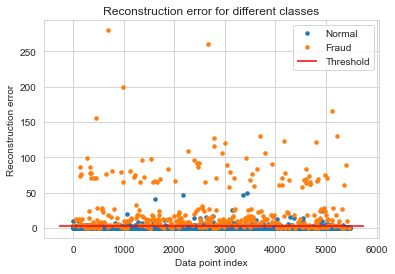

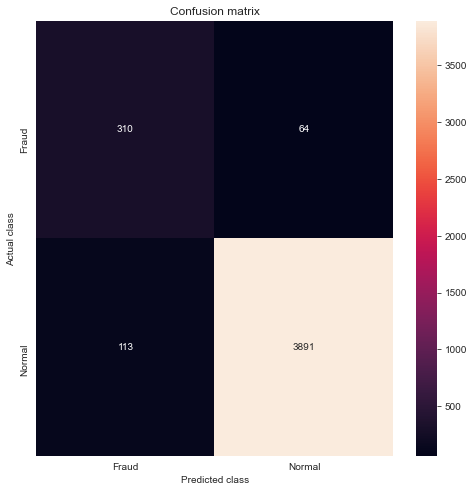

              precision    recall  f1-score   support

           1       0.73      0.83      0.78       374
           0       0.98      0.97      0.98      4004

    accuracy                           0.96      4378
   macro avg       0.86      0.90      0.88      4378
weighted avg       0.96      0.96      0.96      4378


******************Test result*********************
       reconstruction_error   true_class
count           1095.000000  1095.000000
mean               3.140931     0.090411
std               12.583968     0.286901
min                0.101786     0.000000
25%                0.307125     0.000000
50%                0.507698     0.000000
75%                0.839528     0.000000
max              133.724963     1.000000


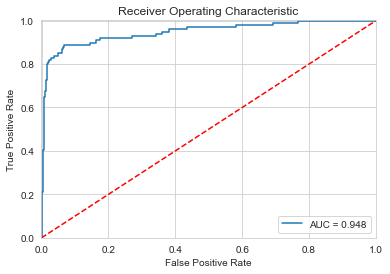

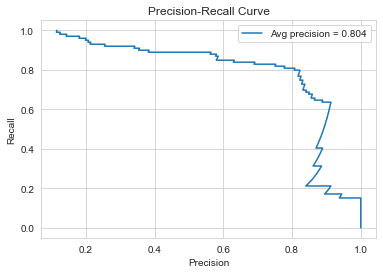

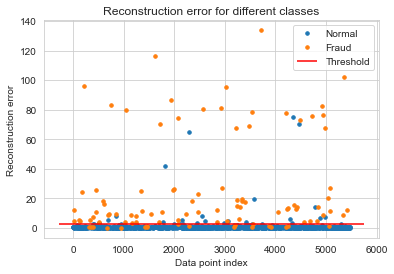

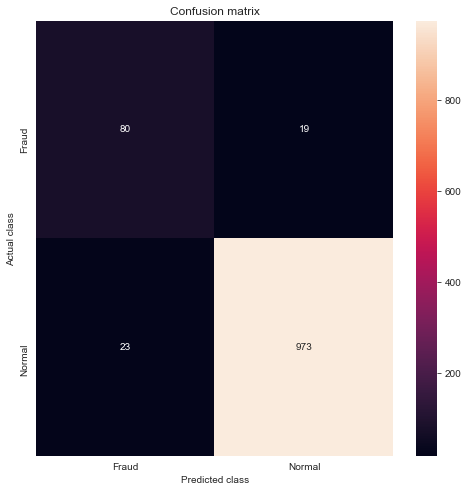

              precision    recall  f1-score   support

           1       0.78      0.81      0.79        99
           0       0.98      0.98      0.98       996

    accuracy                           0.96      1095
   macro avg       0.88      0.89      0.89      1095
weighted avg       0.96      0.96      0.96      1095



In [34]:
# 7.7 Experiment 5c: training results
THRESHOLD = 3

# Get training result
print("******************Training result*********************")

# Reconstruction error (MSE) of normal transaction
score = calc_mse(autoencoder, X_train_normal, y_train_normal)
print('Normal transaction MSE in training set:',score)

X_train_fraud = X_train[y_train==1].values
y_train_fraud = y_train[y_train==1]

# Reconstruction error (MSE) of fraud transaction
score_f = calc_mse(autoencoder, X_train_fraud, y_train_fraud)
print('Fraud transaction MSE in training set:',score_f)

# From these above 2 values, identify the threshold to detect abnomaly
# For any data point larger than threshold will be regard as fraud
print("Threshold level:", THRESHOLD)
predict(autoencoder, X_train, y_train, threshold=THRESHOLD)

# Testing
print("\n******************Test result*********************")
predict(autoencoder, X_test, y_test, threshold=THRESHOLD)